# IDS Assignment Part 1 - <font color="red"><h7>Deadline: 18/12/2022 23:59</h7></font>
This is the first part of the assignments in IDS 2022/2023. 
Please use this Jupyter notebook to work on the questions posed in the assignment. When you are done, upload the notebook in Moodle at the designated activity. This is the _only_ file that is required. A separate report is _not_ needed and will not be considered for grading. 

Give your commented Python code and answers in the corresponding provided cells. Make sure to answer all questions in a clear and explicit manner and discuss your outputs. _Please do not change the general structure of this notebook_. You can, however, add additional markdown or code cells if necessary. <b>Please DO NOT CLEAR THE OUTPUT of the notebook you are submitting! </b>

<font color="red"> *Please make sure to include the names and matriculation numbers of all group members in the slot provided below.* </font> If a name or a student id is missing, the student will not receive any points.

Hint 1: While working on the assignment, you will get a better understanding of the dataset. Feel free to generate additional results and visualizations to support your answers. For example, this might be useful regarding data modification, data simplification, or output interpretation. <font color="red">Ensure that all your claims are supported.</font>

Hint 2: <font color="red">Plan your time wisely. </font> A few parts of this assignment may take some time to run. It might be necessary to consider time management when you plan your group work. Also, do not attempt to upload your assignment at the last minute before the deadline. This often does not work, and you will miss the deadline. Late submissions will not be considered.

Hint 3: RWTHmoodle allows multiple submissions, with every new submission overwriting the previous one. <b>Partial submissions are therefore possible and encouraged. </b> This might be helpful in case of technical issues with RWTHMoodle, which may occur close to the deadline.

<font color="red"><b>Student Names and IDs:
    
    1. Katharina Felderhoff 379157
    
    2. Debabrata Ghosh 441275
    
    3. Amogh Warkhandkar 442481

For those using Jupyter Notebook in your local environments, please install the following library in your environment:
```pip install umap-learn==0.5.3```

In [48]:
#your imports (only use libraries provided in the environment)
import numpy as np
import pandas as pd
import sklearn
from sklearn.model_selection import train_test_split, KFold
from sklearn.metrics import mean_squared_error, mean_absolute_error
from p_decision_tree.DecisionTree import DecisionTree
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import pydotplus
import networkx
import re
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler
from sklearn.cluster import KMeans
from sklearn.linear_model import LinearRegression
from sklearn.svm import LinearSVR, SVR
from sklearn.neural_network import MLPRegressor

# Pricing your AirBnB

You finally made it! Working as a data scientist at an established process mining company in New York, you earned so much money that you can buy a flat for yourself. You decide to buy a 2-room apartment in Manhattan. Congratulations!

Currently, you are still living in your rental apartment and are tied to a long-running rental contract. You can only use the apartment in 5 years from now. Therefore, you want to use the apartment as an AirBnB in the meantime, generating some consistent income. 


You have no clue how you should price your AirBnB per night (you are living in New York, so you never needed to book an AirBnB). You decide to leverage your unique skill set and perform a data-driven, informed decision. You collect all the data you can get your hands on by traversing all New York apartments. The retrieved data set **AirBnB_original.csv** is your starting point for investigation.

## Question 1: Exploring the Data Set (18 points)

As with every data set, you first want to know what you are dealing with. You perform some exploratory data analysis and clean the data along the way.

Show a few data points contained in the data set. Include all attributes. **(0.5 point)**

In [2]:
# Your answer goes here
airbnbData = pd.read_csv('AirBnB_original.csv')
airbnbData.head()

,id,host id,neighborhood group,neighborhood,lat,long,country,country code,instant bookable,cancellation policy,room type,construction year,price,service fee,minimum nights,number of reviews,review rate number,calculated host listings count,number rooms
0,1001254,80014485718,Brooklyn,Kensington,40.64749,-73.97237,United States,US,0,strict,Private room,2020.0,966,193.0,7.0,9.0,4.0,6.0,1
1,1002102,52335172823,Manhattan,Midtown,40.75362,-73.98377,United States,US,0,moderate,Entire home/apt,2007.0,142,28.0,7.0,45.0,4.0,2.0,2
2,1002403,78829239556,Manhattan,Harlem,40.80902,-73.94190,United States,US,0,flexible,Private room,2005.0,620,124.0,3.0,0.0,5.0,1.0,1
3,1002755,85098326012,Brooklyn,Clinton Hill,40.68514,-73.95976,United States,US,0,moderate,Entire home/apt,2005.0,368,74.0,7.0,270.0,4.0,1.0,2
4,1003689,92037596077,Manhattan,East Harlem,40.79851,-73.94399,United States,US,0,moderate,Entire home/apt,2009.0,204,41.0,7.0,9.0,3.0,1.0,1


### Basic Cleaning (4 points)

First, you have to remove NaN entries across the data set such that we only keep rows without any NaN value. How many rows did you remove? **(0.5 points)**

In [3]:
# Your answer goes here
airbnbNaDropped = airbnbData.dropna().reset_index(drop=True)
dropped_rows = airbnbData.shape[0] - airbnbNaDropped.shape[0]
print(f'We removed {dropped_rows} rows!')

We removed 1477 rows!


Since duplicated entries are misleading, we want to remove duplicate flats (identified by their id), such that we only keep them once and create a new dataset. How many duplicates are removed? **(0.5 point)**

In [4]:
# Your answer goes here
airbnbWithoutDuplicates = airbnbNaDropped.drop_duplicates(subset=['id']).reset_index(drop=True)
dropped_duplicates = airbnbNaDropped.shape[0] - airbnbWithoutDuplicates.shape[0]
print(f'We removed {dropped_duplicates} duplicate rows!')

We removed 389 duplicate rows!


From now on, you work with the dataset **AirBnB_cleaned.csv**.

To get a feeling for nightly prices in New York, you take a look at the price attribute. Calculate the average price, the first and third quantiles, and the standard deviation. **(1 point)**

In [5]:
# Your answer goes here
airbnbCleaned = pd.read_csv('AirBnB_cleaned.csv')
avgPrice = airbnbCleaned['price'].mean()
firstQuantilePrice = airbnbCleaned['price'].quantile(0.25)
thirdQuantilePrice = airbnbCleaned['price'].quantile(0.75)
stdPrice = airbnbCleaned['price'].std()
print(f'Average price of AirBnBs in New York is: {avgPrice}')
print(f'First quantile of price of AirBnBs in New York is: {firstQuantilePrice}')
print(f'Third quantile of price of AirBnBs in New York is: {thirdQuantilePrice}')
print(f'Standard deviation of price of AirBnBs in New York is: {stdPrice}')

Average price of AirBnBs in New York is: 625.4636797380085
First quantile of price of AirBnBs in New York is: 340.0
Third quantile of price of AirBnBs in New York is: 913.0
Standard deviation of price of AirBnBs in New York is: 331.23624102553555


You want to get a more visual picture of the price range. Use a histogram and boxplot to show the distribution of prices on the entire dataset. **(2 points)**

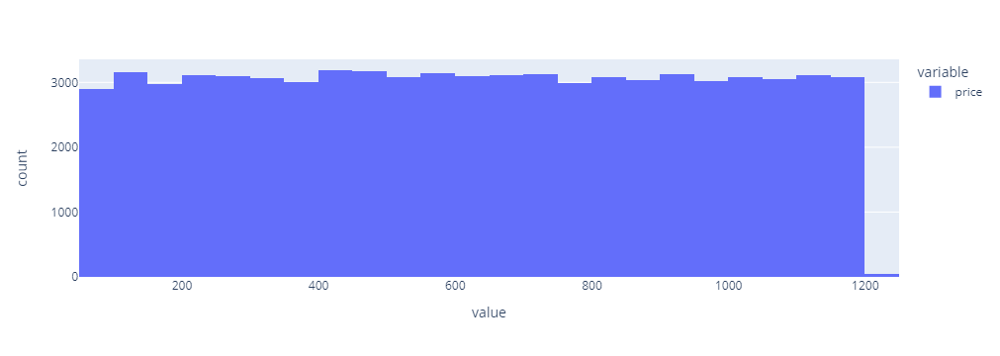

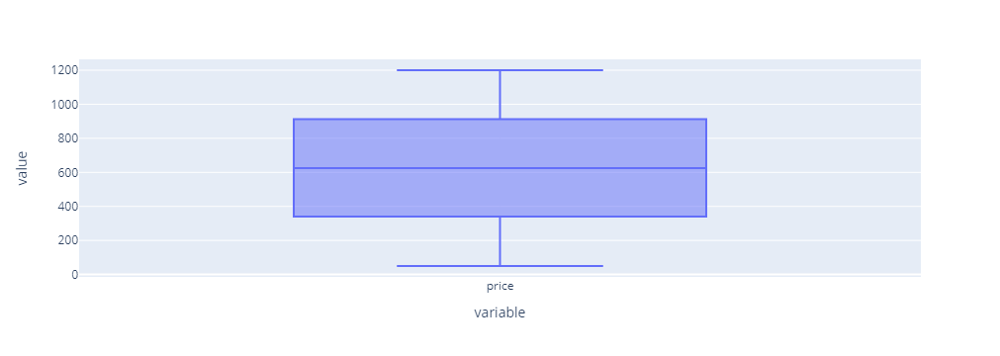

/opt/conda/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='price'>

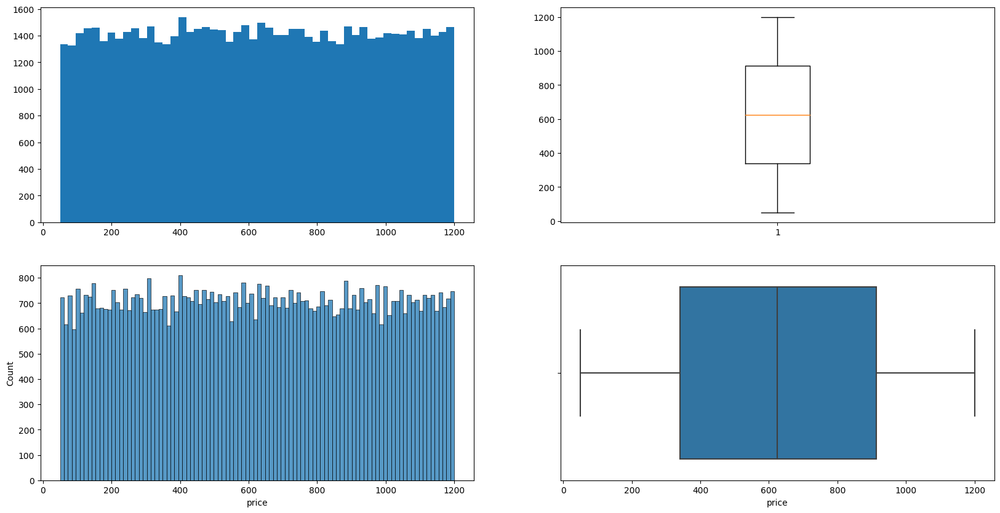

In [8]:
# Your answer goes here
#Plotly graph: Histogram looks confusing because of the binning strategy (max value 1200 is inclusive in the highest bin)
fig = px.histogram(airbnbCleaned["price"], nbins=50)
fig.show()

fig = px.box(airbnbCleaned["price"])
fig.show()

fig, (ax1, ax2) = plt.subplots(2, 2, figsize = (20, 10))
ax1[0].hist(airbnbCleaned['price'], bins = 50)
ax1[1].boxplot(airbnbCleaned['price'])
sns.histplot(airbnbCleaned['price'], kde=False, bins=100, ax=ax2[0])
sns.boxplot(airbnbCleaned['price'], ax=ax2[1])

### Exploring Price Relationships (3 points)

To inform our pricing decision, we want to investigate some differentiating factors for pricing apartments.

Since you have an overview of the prices and their distribution, you want to investigate which features of your dataset you might use to make your pricing decision. To do so, discuss each feature of the dataset and already rule out features that will definitely not impact the pricing decision. Below you can find a brief description of each feature: 

- id: Unique identifier for an apartment
- host id: Identifier of the host offering a certain apartment
- neighborhood group: Name of a neighborhood group in which an apartment is located
- neighborhood: More fine-grained view on neighborhoods than neighborhood group
- lat: Latitude coordinate of an apartment
- long: Longitude coordinate of an apartment
- country: The country in which an apartment is located
- country code: Code of the country in which an apartment is located
- instant bookable: Boolean values if an apartment is instantly bookable
- cancellation policy: Policy for cancellation of booking
- room type: Type of apartment/room
- construction year: Year of construction of apartment
- price: Price for renting an apartment
- service fee: Fee of service
- minimum nights: Number of minimum nights to rent an apartment
- number of reviews: Number of reviews for an apartment
- review rate number:  Review rate for an apartment (1 to 5)
- calculated host listings count: Number of listings a host has
- number rooms: Number of rooms in an apartment


['United States']
['US']
[0]


<AxesSubplot:>

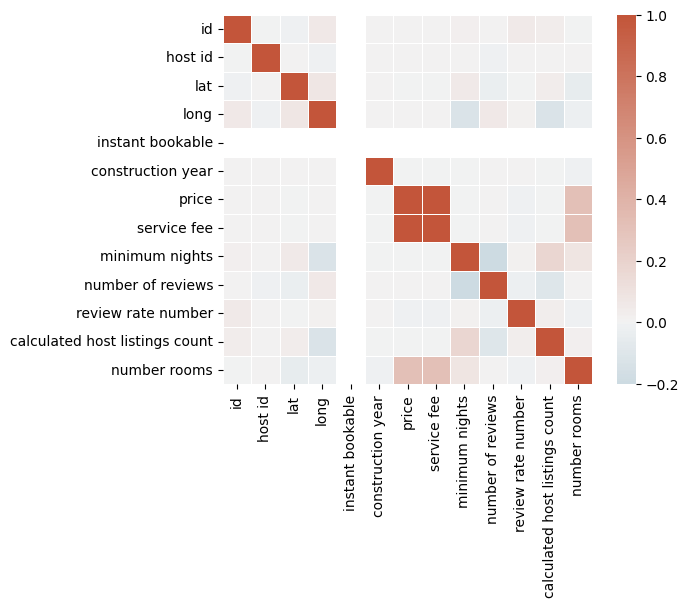

In [24]:
# Your answer goes here
print(airbnbCleaned["country"].unique())
print(airbnbCleaned["country code"].unique())
print(airbnbCleaned["instant bookable"].unique())
corr = airbnbCleaned.corr()
# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, cmap=cmap, center=0,
            square=True, linewidths=.5)

_Answer:_ We consider each individual feature on the data one by one:

- <font color="red">id: It's an unique identifier for each apartment which is not informative in predicting the price of the apartment. So, it's not useful.
- <font color="red">host id: It's an unique identifier for each host which is not useful for predicting the price of the apartment.
- <font color="green">neighborhood: The price of an apartment can depend on the neighborhood.
- <font color="orange">neighborhood group: It might be an important feature but if we keep neighborhood we can retrieve the neighborhood group information from neighborhood. So it's a redundant feature that can be dropped.
- <font color="orange">lat:  lat might indirectly influence the price, but the for pricing important information might already be included in neighborhood.
- <font color="orange">long:  just like lat, long might indirectly influence the price, but the for pricing important information might already be included in neighborhood.
- <font color="red">country: country is the same ('US') for all apartments and therefore do not give any information and can be definitely dropped.
- <font color="red">country code: country code too is the same for all apartments and can be dropped.
- <font color="red">instant bookable: instant bookable is 0 for all apartments and not useful for predicting the price and should be dropped.
- <font color="green">cancellation policy: From the description it seems useful.
- <font color="green">room type: Price of an apartment will depend on the room type. So, we'll keep it.
- <font color="green">construction year: It can indirectly affect the price depending upon the maintenance cost. 
- <font color="green">price: This is what we are predicting.
- <font color="green">service fee: It's not clear how the service fee will affect the price, but we can see a strong correlation between the two variables. So, we are going to keep it for now.
- <font color="green">minimum nights: It might be useful to decide the price of an apartment.
- <font color="green">number of reviews: Number of reviews might indirectly affect the pricing.
- <font color="green">review rate number:  Same as number of reviews.
- <font color="green">calculated host listings count: It could be useful.
- <font color="green">number rooms: Number of rooms will definitely affect the price. So, we won't drop it.


### Univariate Analysis (4.5 points)

In the following, you want to analyze which features influence the price. You do this univariately, i.e., look at the relationship between one feature and the price individually. No matter which features you concluded to be useful in the last task, **you will consider the following seven features: service fee, minimum nights, neighborhood group, room type, cancellation policy, construction year, and the number of rooms.**

First, we look closely at the relationship between price and service fee. To do so, create a joint plot for these two attributes. What is your finding? Is this a helpful feature for our pricing decision? **(1 point)**

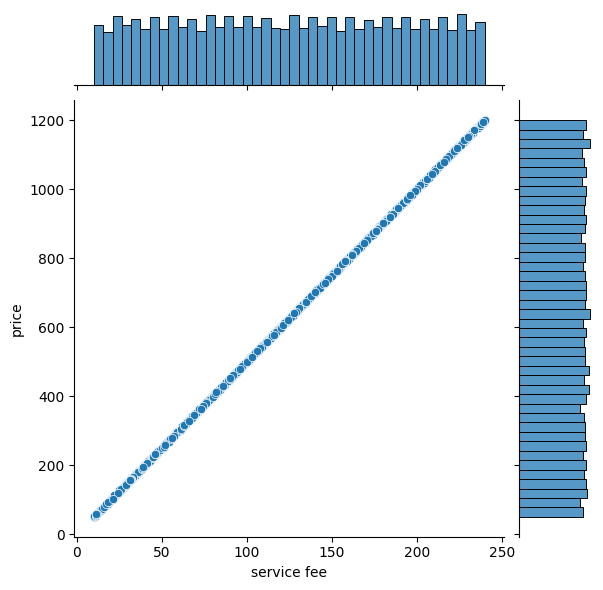

In [26]:
# Your answer goes here
sns.jointplot(data = airbnbCleaned, x = 'service fee', y = 'price')

_Answer:_ Price and Service fee are strongly correlated and it could be influential in predicting the price, however, we are not sure which variable affects the other (whether the service fee will influence the price or the price will influence the service fee).



Next, we are interested in the relationship between the number of minimum nights and the price. To analyze it, create a joint plot with a regression. Describe your observation. **(1 point)**

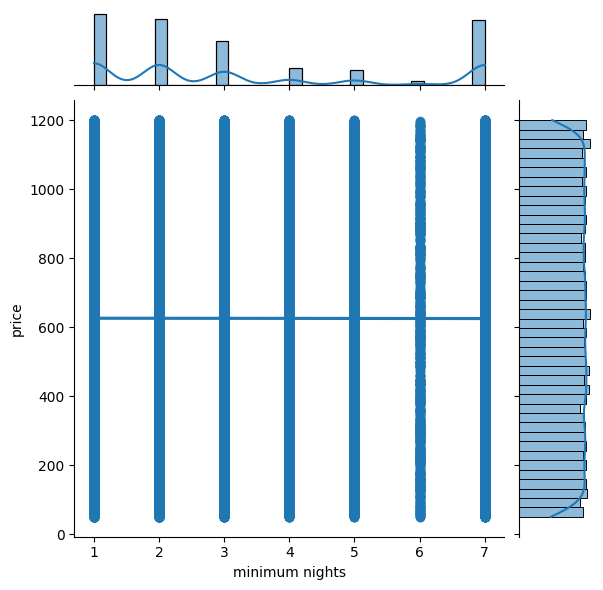

In [28]:
# Your answer goes here
sns.jointplot(data = airbnbCleaned, x = 'minimum nights', y = 'price', kind="reg")

_Answer:_ For similar value of minimum number of nights we see a wide range of pricing which doesn't help us in predicting the price and the regression line also implies that pricing is constant for all values of minimum nights.



To further investigate the pricing decision, you look at the remaining five features: neighborhood group, room type, cancellation policy, construction year, and the number of rooms.
To get an overview, you decide to create box plots (including the mean) for each of these features to visualize their influence on the price. Describe your findings. Which values of the features influence the price? **(2.5 point)**

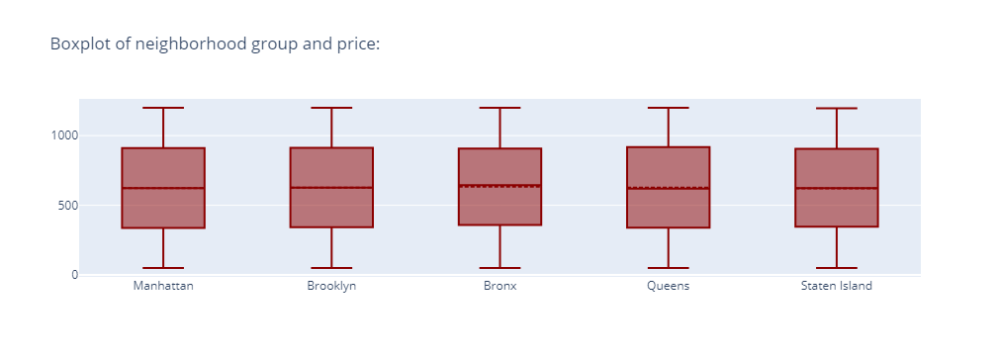

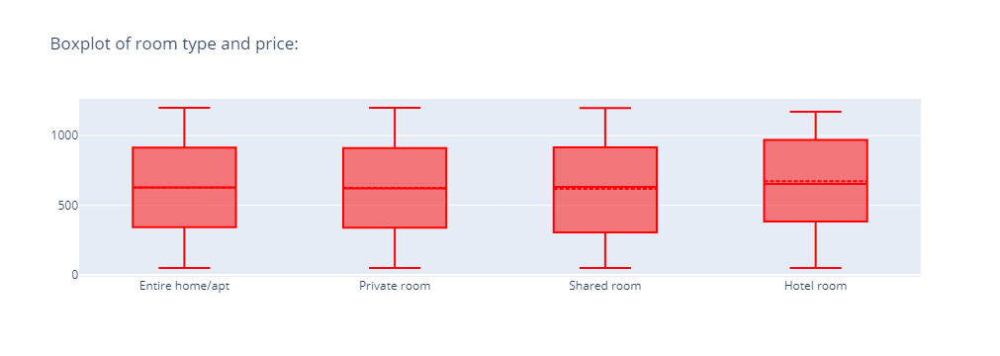

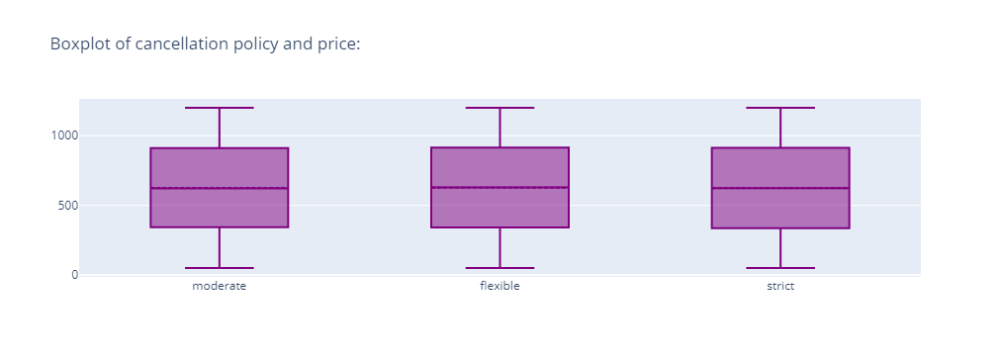

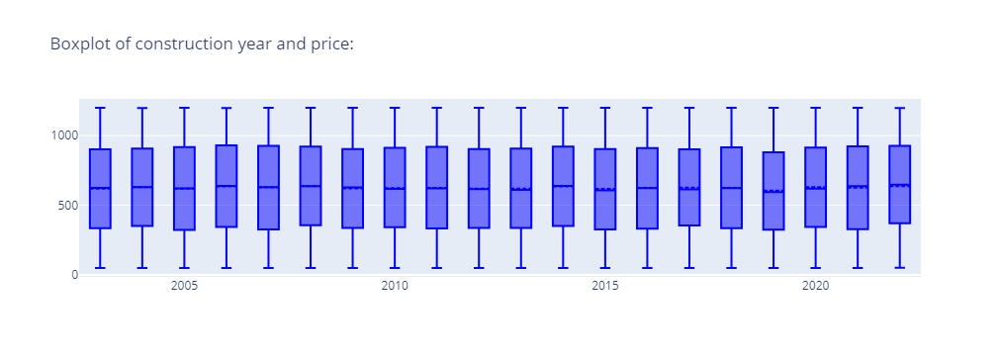

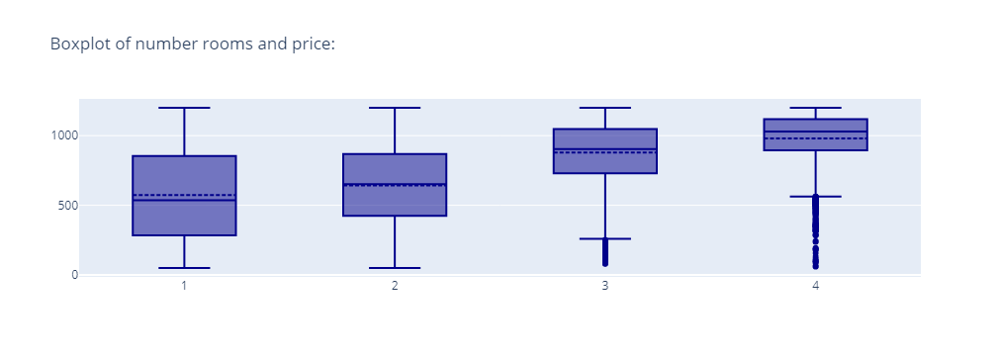

In [36]:
# Your answer goes here
features = [
    "neighborhood group",
    "room type",
    "cancellation policy",
    "construction year",
    "number rooms",
]

colors = ['darkred', 'red', 'purple', 'blue', 'darkblue']
for (i, feature) in enumerate(features):
    fig = go.Figure()
    fig.add_trace(go.Box(
    x=airbnbCleaned[feature], y=airbnbCleaned["price"],
    marker_color=colors[i],
    boxmean=True #represents mean,
    ))
    fig.update_layout(
    title="Boxplot of " + feature + " and price:"
)
    fig.show()
    

_Answer:_ Neighborhood group and cancellation policy do not influence the price, as respectively all boxplots look the same for each category.

Room type only seems to influence the price if it is of category hotel room. Then the price is set higher.

There are small variations in the price distribution for different construction years, but no big overall changes or trends.

At last, number of rooms seem to highly influence the pricing. Although the range of prices for each value of 'number of rooms' is quite similar, the distribution shows that prices get higher as the number of rooms increases.

So, room type, construction year, number rooms influence the pricing of the apartment, neighborhood group and cancellation policy not so much.

### Multivariate Analysis (5 points)

As the univariate analysis of price relationships provided only limited insights, you decide to visualize some multivariate investigations of the price. **No matter what you concluded in the last section, you will use the features construction year, number of rooms, cancellation policy, room type, and neighborhood group in the multivariate analysis.**
For each pair of features, create a grouped boxplot (using the hue argument) and investigate whether the two features together allow for an explanation of price differences. In the end, conclude which combination of features should be used to make your pricing decision. 

#### Multivariate Analysis for Neighborhood Group 

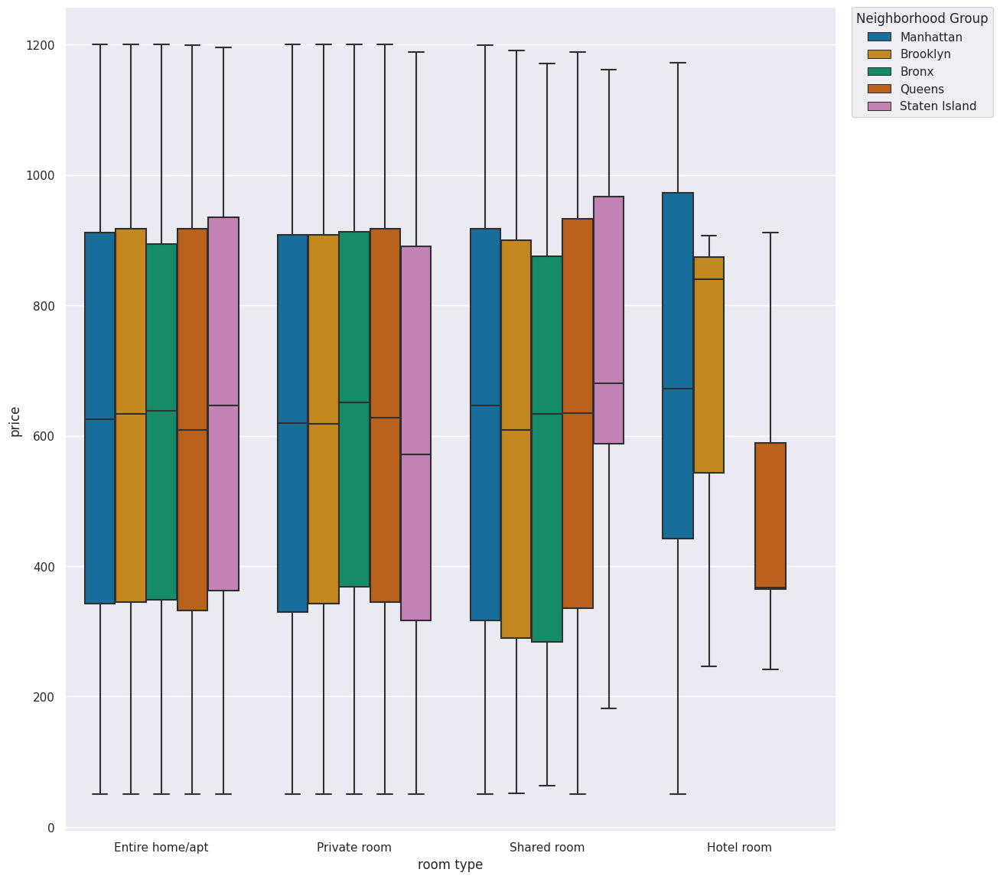

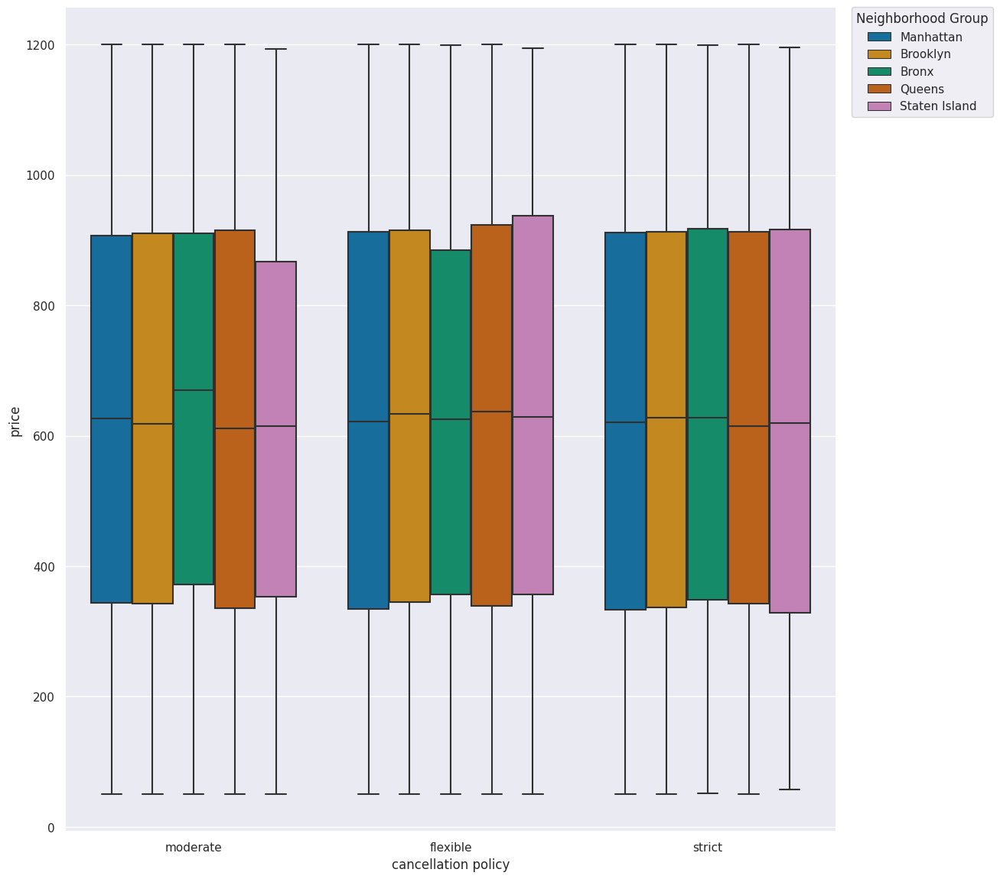

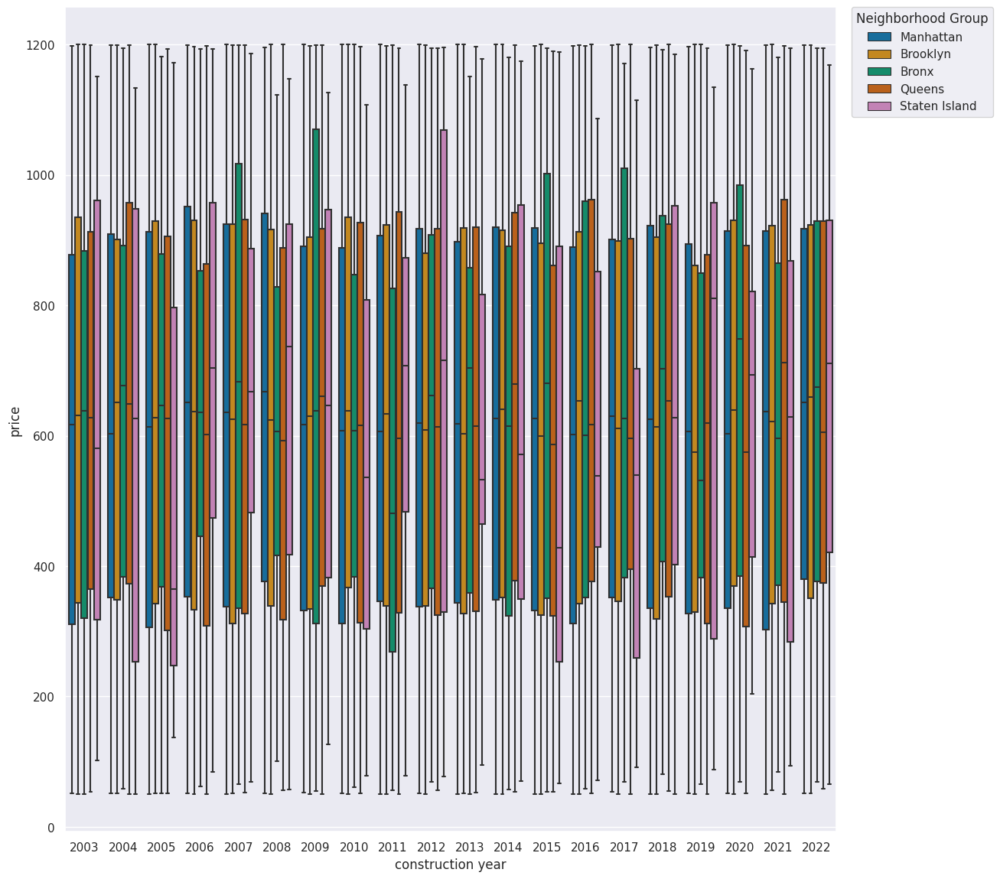

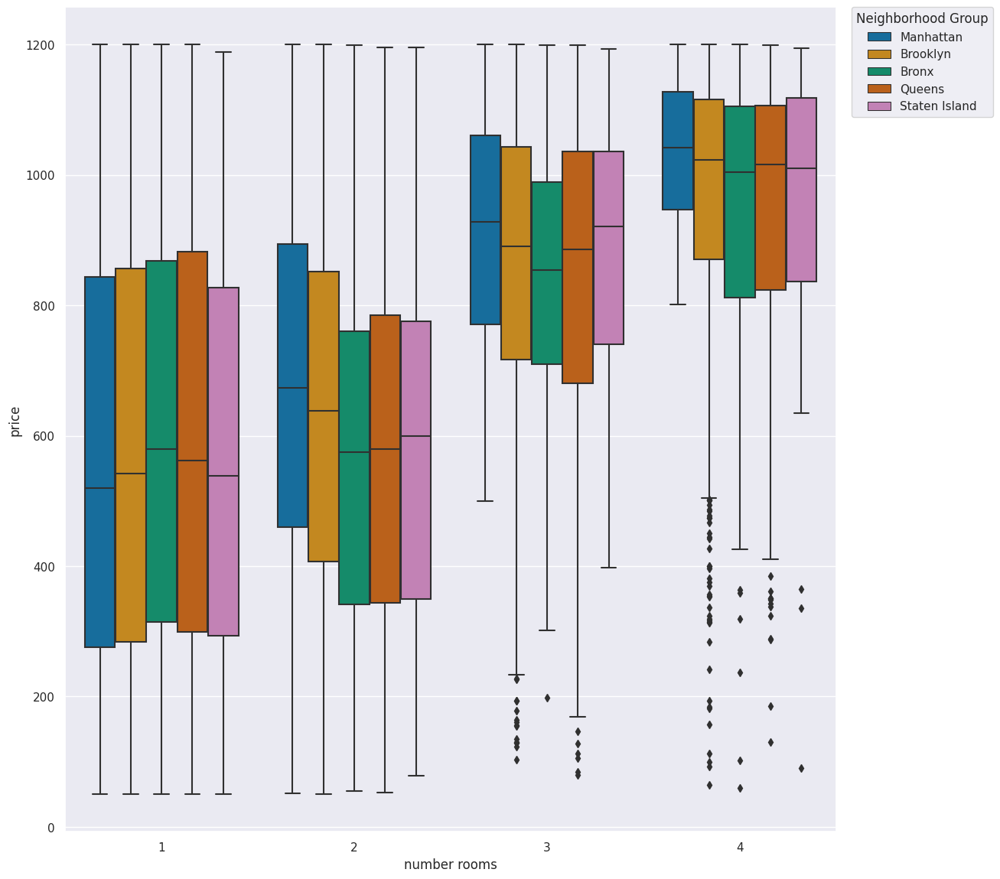

In [49]:
# Your answer goes here
sns.set(rc={"figure.figsize":(13, 14)})
for feature in [
    "room type",
    "cancellation policy",
    "construction year",
    "number rooms",
]:
    sns.boxplot(
        y="price",
        x=feature,
        data=airbnbCleaned,
        palette="colorblind",
        hue="neighborhood group",
        
    )
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, title="Neighborhood Group")
    plt.show()

_Answer:_ From the boxplots we can see that there are no hotel rooms in Bronx and Staten Island. The other variables together with neighborhood group do not influence the price in a way which is different from what we already observed in the univartiate analysis.



#### Multivariate Analysis for Room Type

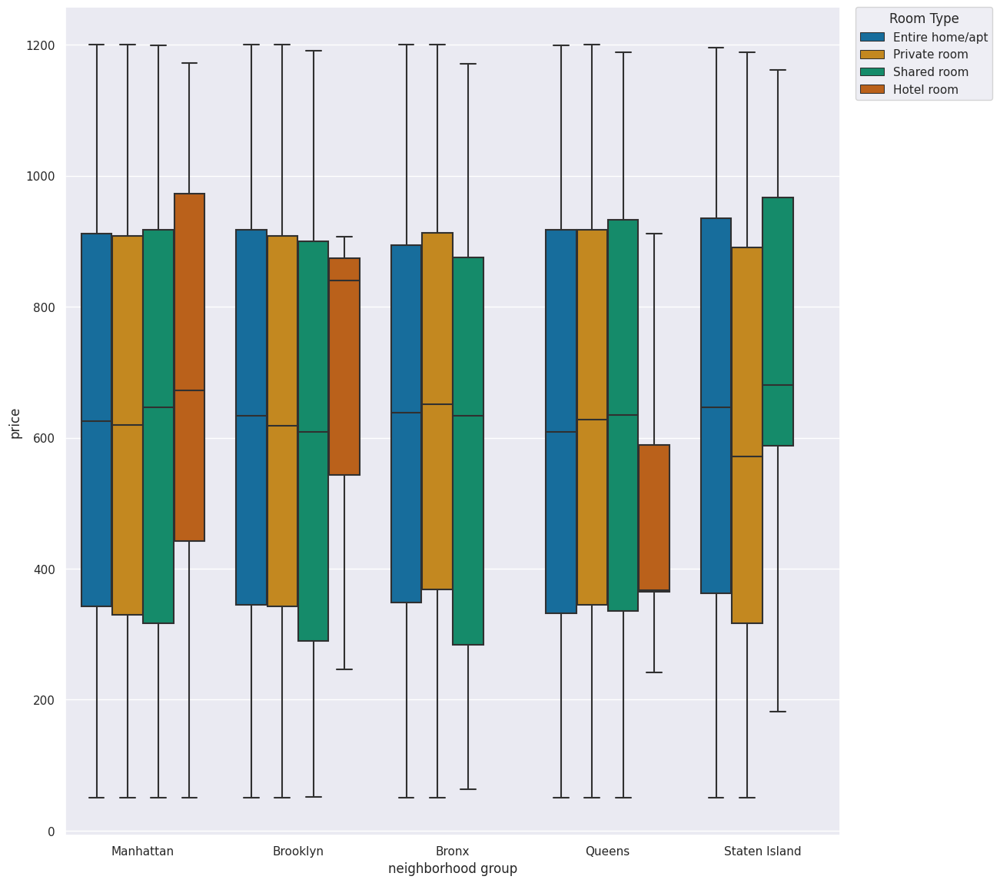

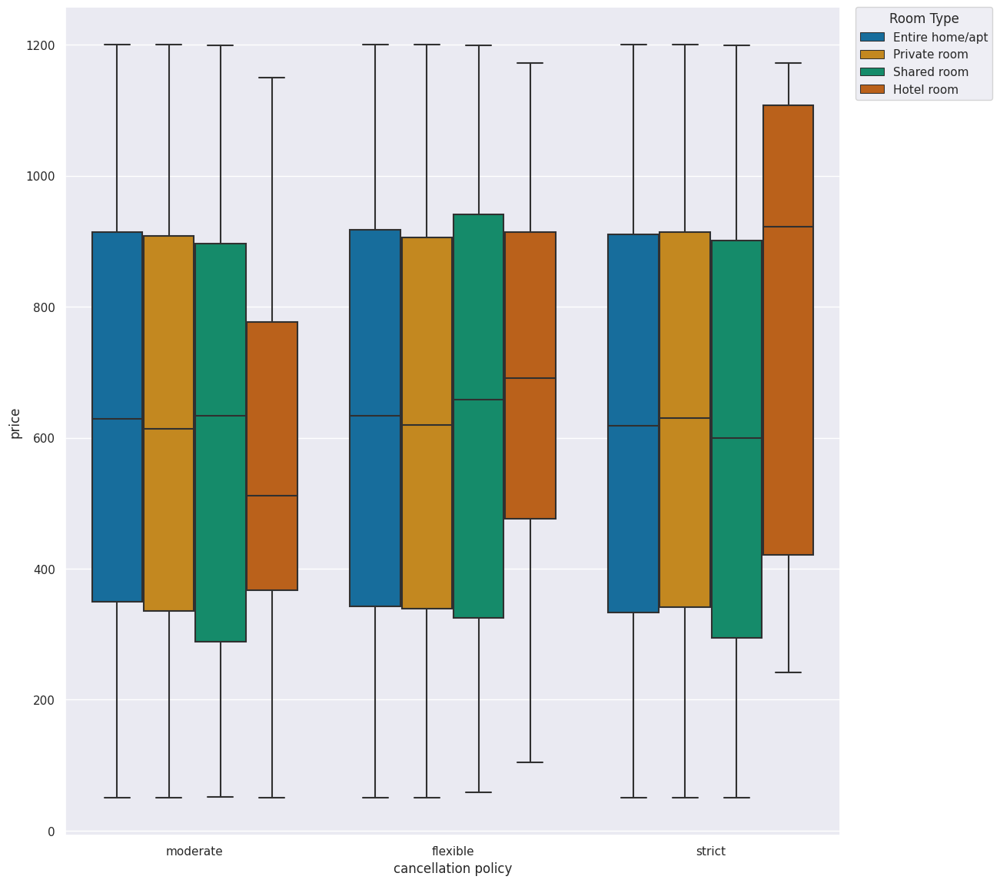

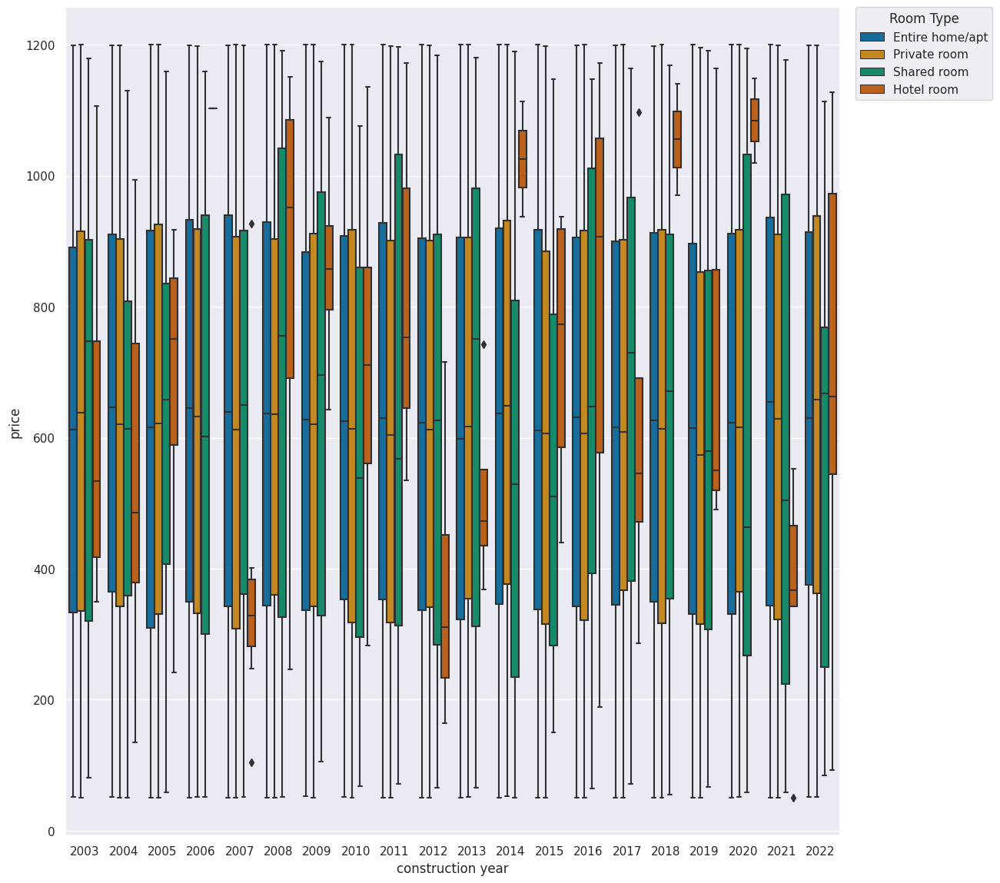

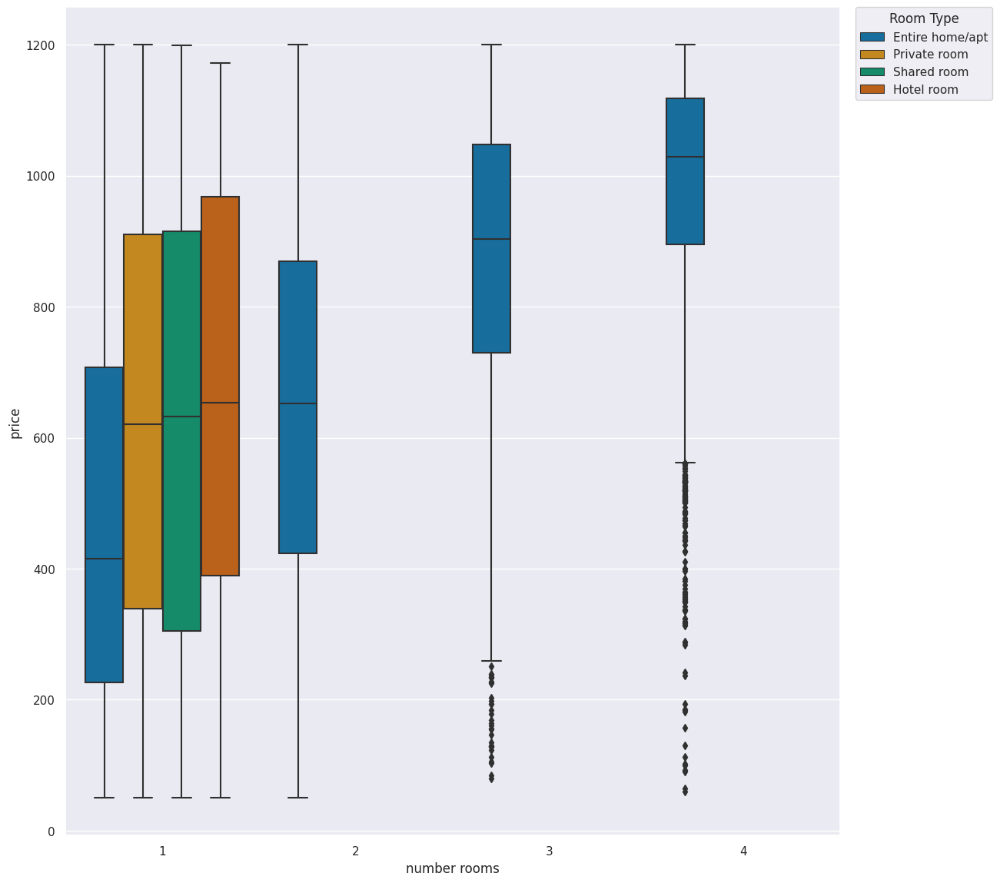

In [54]:
# Your answer goes here
for feature in [
    "neighborhood group",
    "cancellation policy",
    "construction year",
    "number rooms",
]:
    sns.boxplot(
        y="price", x=feature, data=airbnbCleaned, palette="colorblind", hue="room type"
    )
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, title="Room Type")
    plt.show()

_Answer:_ We notice that only for hotel rooms the pricing changes for different categories in the given variables but for other room types price doesn't vary much for different combinations of room type and the other 4 features. Moreover, with number of rooms we don't have enough data to conclude any influnce on pricing.


#### Multivariate Analysis for Number of Rooms

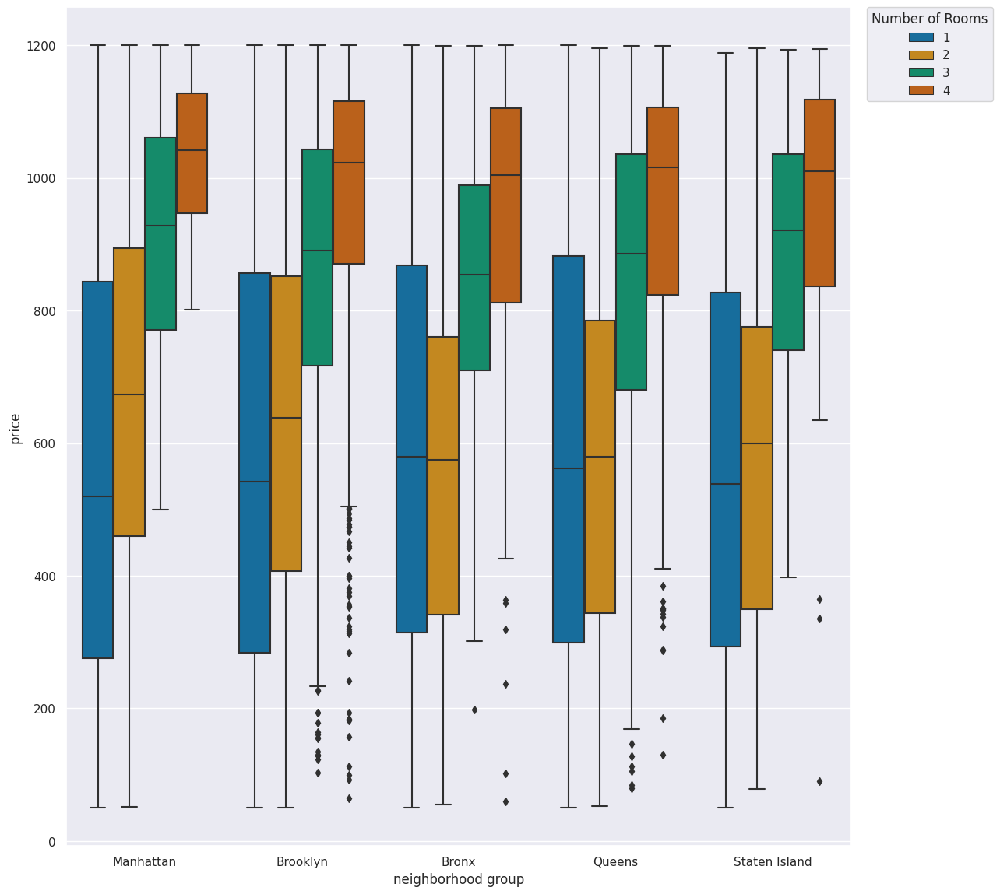

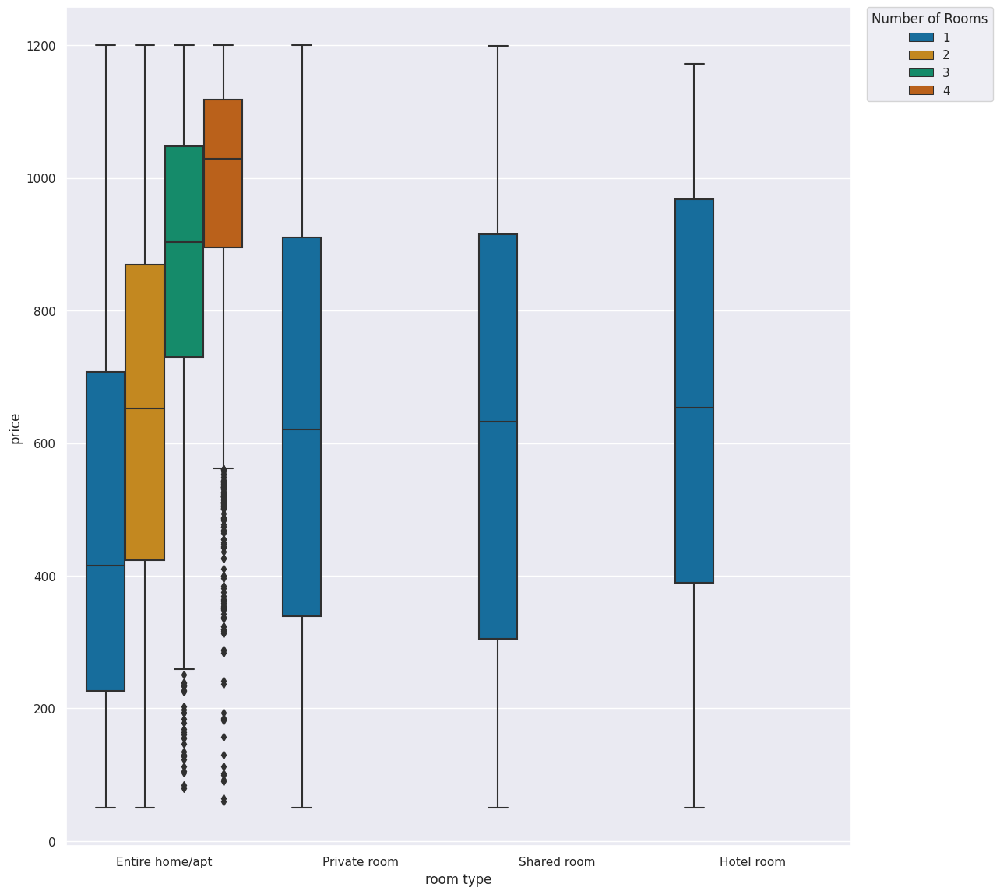

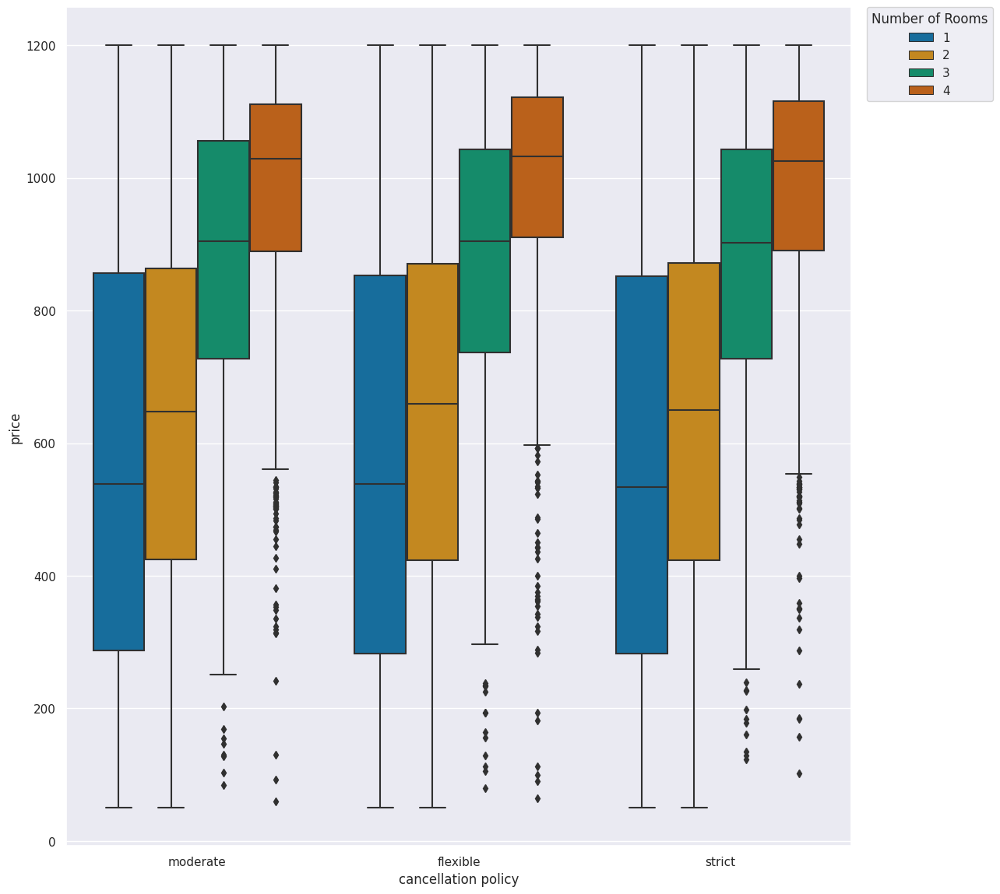

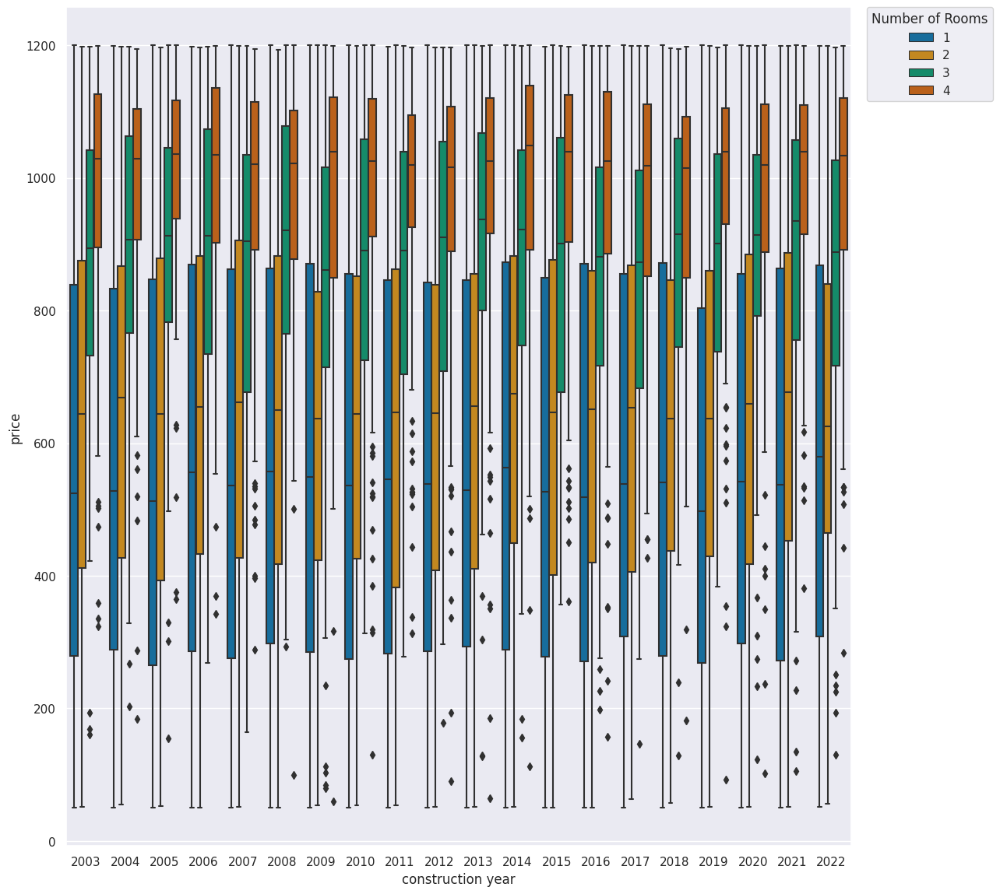

In [55]:
# Your answer goes here
for feature in [
    "neighborhood group",
    "room type",
    "cancellation policy",
    "construction year",
]:
    sns.boxplot(
        y="price",
        x=feature,
        data=airbnbCleaned,
        palette="colorblind",
        hue="number rooms",
    )
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, title="Number of Rooms")
    plt.show()

_Answer:_ From the boxplots we can see that there is not enough data for combinations of room type and number of rooms. For the other variables together with number of rooms do not influence the price in a way which is different from what we already observed in the univartiate analysis.


#### Multivariate Analysis for Construction Year

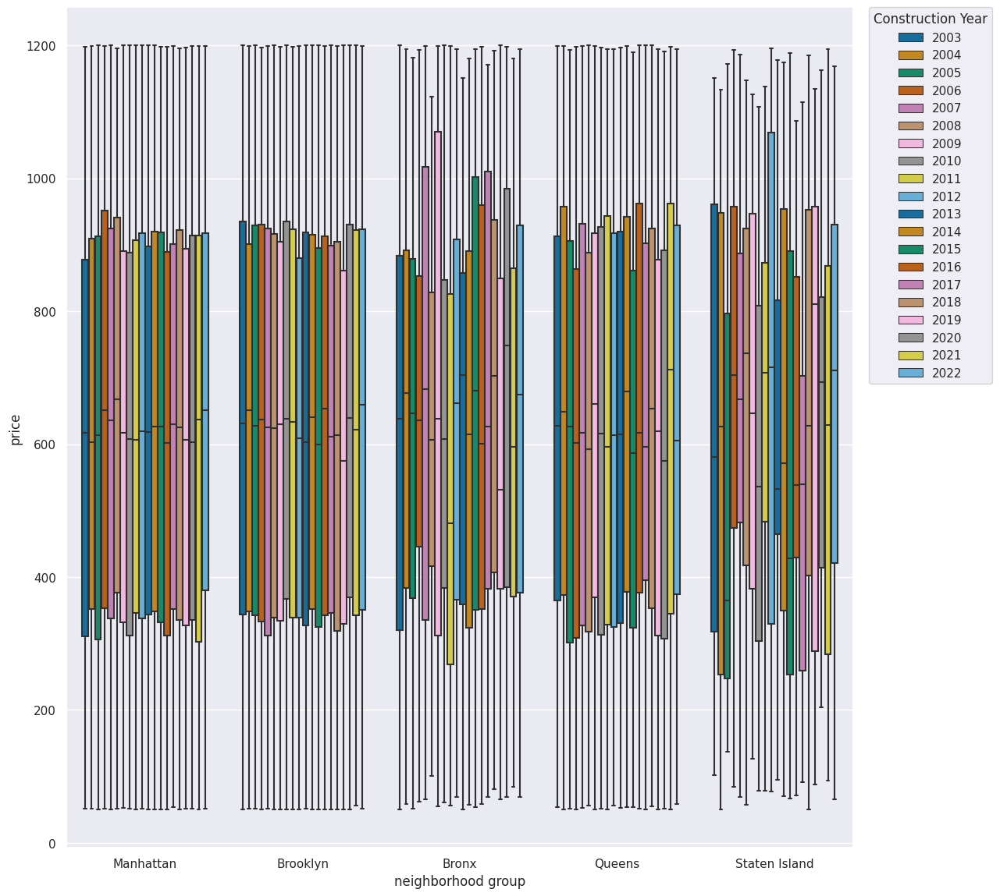

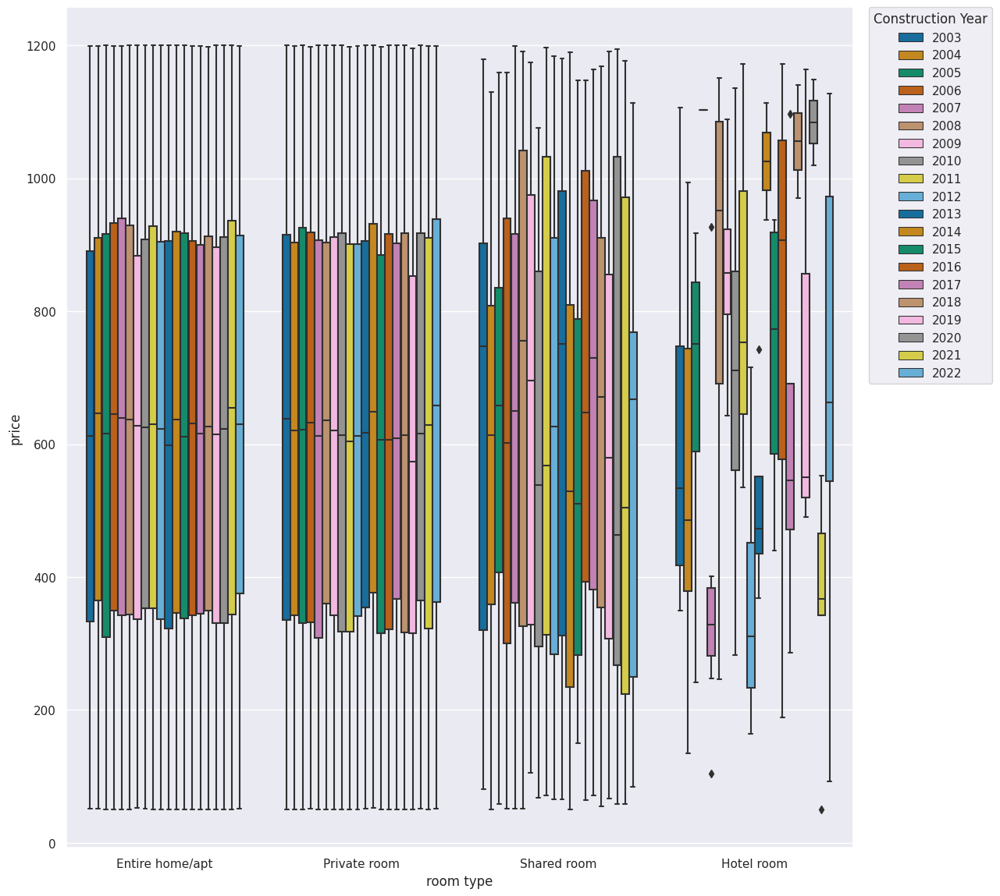

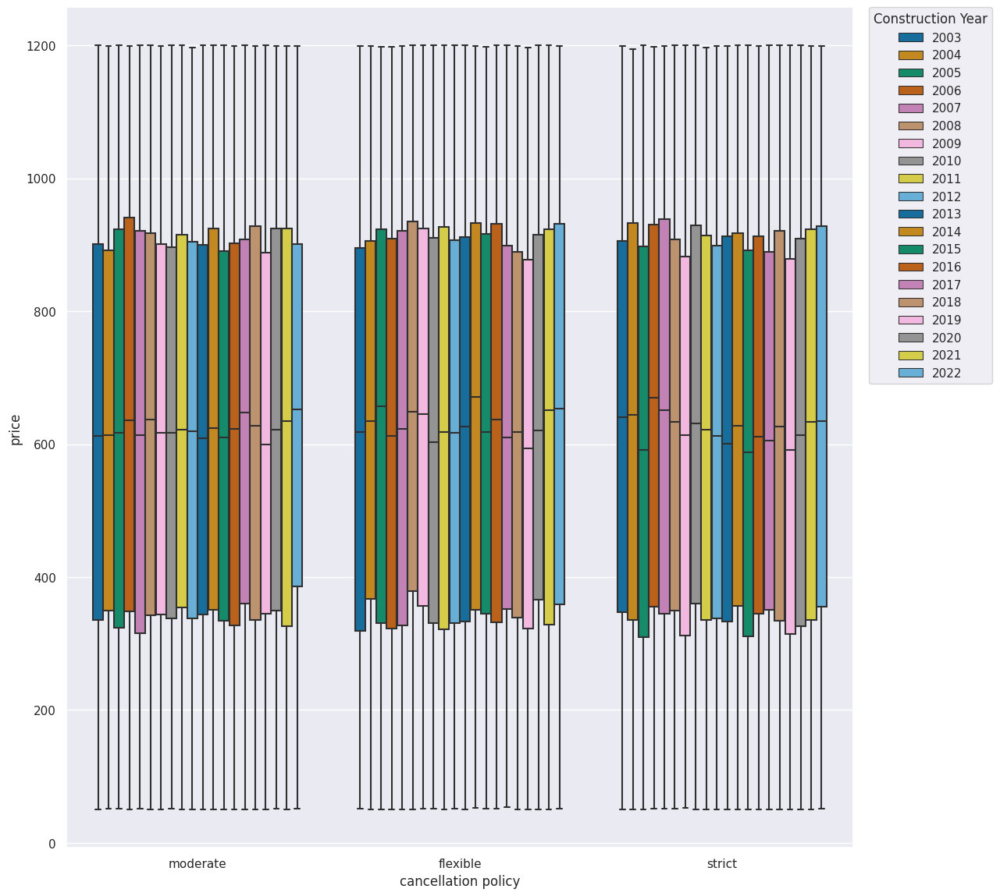

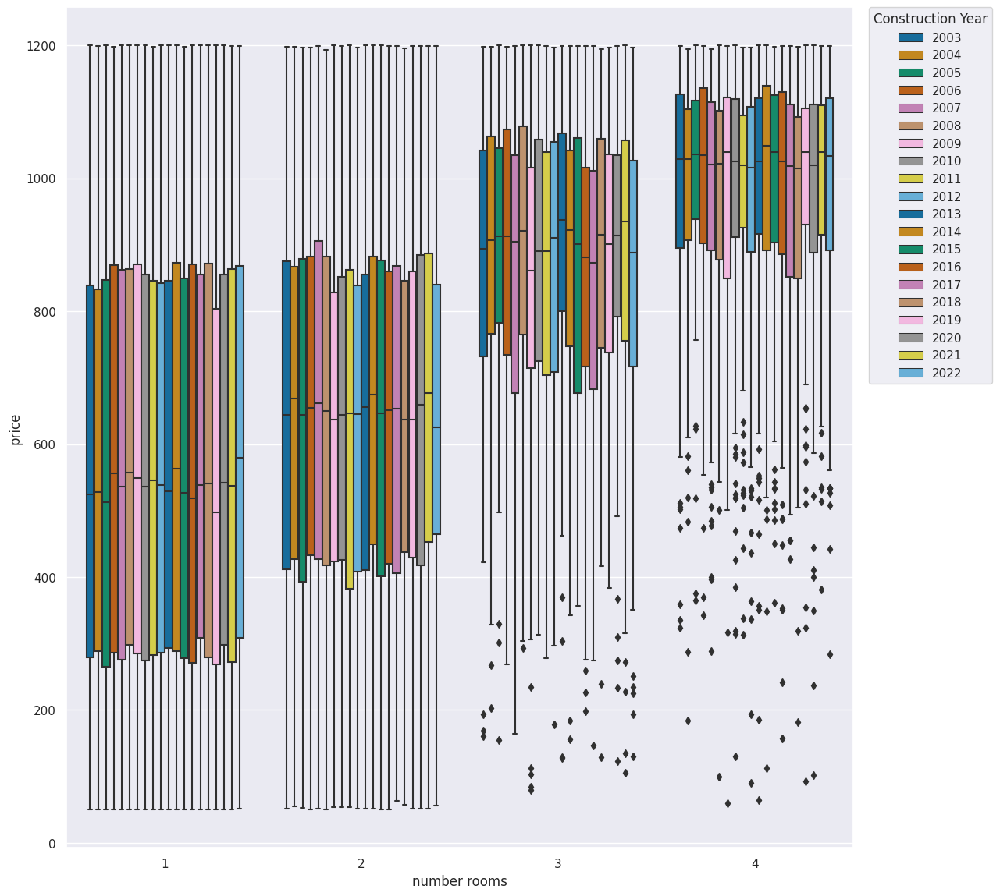

In [53]:
# Your answer goes here
for feature in [
    "neighborhood group",
    "room type",
    "cancellation policy",
    "number rooms",
]:
    sns.boxplot(
        y="price",
        x=feature,
        data=airbnbCleaned,
        palette="colorblind",
        hue="construction year",
    )
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, title="Construction Year")
    plt.show()

_Answer:_ The pricing of the hotel rooms vary widely within different construction years, but this does not influence the pricing decision of our apartment we will not offer a hotel room. All other variables along with construction years doesn't influence the pricing that differs from the trend we saw in univariate analysis.

### Selection of Variables (1 point)

Please argue: Which combinations of variables would you consider for pricing your AirBnB?

_Answer:_ The number of rooms on its own gives strong indication for the price. To get better understanding we would recommend using the combination room type, neighborhood group, number of rooms and construction year according to our findings in univariate and multivariate analysis. Also, if the service fee influences the price and not the other way round, we would also consider this variable.


## Question 2: Setting the Price (45 points)

No matter what you have deducted from your analysis, from now on, you will continue only with three features: **The number of rooms, the neighborhood group, and the room type.**

**Enter Toby**: Toby is your long-term bruh back from studying at RWTH. While you studied computer science, Toby studied business administration to become a big shot at Wall Street. He currently works in the back office of some swiss credit institute just across the corner from your office. You decide to drop by and get some of his input for your pricing decision. 

Toby proposes to first use comparables pricing to price your apartment. Comparables pricing is an established concept in economics and means that you price your apartment close to similar apartments. 
You will use different techniques to find similar apartments and set a price.

## Baseline (5 points)

First, you want to set a baseline to compare against. You use the mean absolute error as metric. The baseline should always use the average price of all apartments as a recommended price. Evaluate on a test set of 5%. The same test set should also be used later (you can use the random_state argument in scikit learn's train_test_split, but you need to stay consistent for different questions).

In [68]:
# Your answer goes here
airbnb = airbnbCleaned[["number rooms", "neighborhood group", "room type", "price"]]
airbnbX = airbnb[["number rooms", "neighborhood group", "room type"]].values
airbnby = airbnb["price"].values
airbnbX_train, airbnbX_test, airbnby_train, airbnby_test = train_test_split(airbnbX, airbnby, test_size=0.05, random_state=123)

avgPriceTrain = np.mean(airbnby_train)
avg_predicted = np.array([avgPriceTrain for i in range(len(airbnby_test))])
mean_abs_error_avg = mean_absolute_error(airbnby_test, avg_predicted)
print(f"𝒯𝒽𝑒 𝓂𝑒𝒶𝓃 𝒶𝒷𝓈𝑜𝓁𝓊𝓉𝑒 𝑒𝓇𝓇𝑜𝓇 𝒾𝓈 {mean_abs_error_avg}.")

𝒯𝒽𝑒 𝓂𝑒𝒶𝓃 𝒶𝒷𝓈𝑜𝓁𝓊𝓉𝑒 𝑒𝓇𝓇𝑜𝓇 𝒾𝓈 287.5423527234528.


## Decision Tree (15 points)

Using a decision tree, you try to price your apartment according to similar apartments. 

In the following, we want to know the price ranges for renting AirBnBs. To use decision trees, you need to discretize prices. We use the following price bins:


- [50, 200]
- (200, 400]
- (400, 600]
- (600, 800]
- (800, 1000]
- (1000, 1200]

We add the attribute "Price_Bins" using the discretization mentioned above for each apartment. For example, if an apartment costs 404, it is put into the bin (400, 600]. **(2 points)**

In [59]:
# Your answer goes here
pd.options.mode.chained_assignment = None
def priceBinning(price):
    if 50 <= price <= 200:
        return '[50, 200]'
    elif 200 < price <= 400:
        return '(200, 400]'
    elif 400 < price <= 600:
        return '(400, 600]'
    elif 600 < price <= 800:
        return '(600, 800]'
    elif 800 < price <= 1000:
        return '(800, 1000]'
    else:
        return '(1000, 1200]'
    
airbnb["Price_Bins"] = airbnb["price"].apply(lambda x: priceBinning(x))
airbnb.head()

,number rooms,neighborhood group,room type,price,Price_Bins
0,2,Manhattan,Entire home/apt,142,"[50, 200]"
1,1,Manhattan,Private room,620,"(600, 800]"
2,2,Brooklyn,Entire home/apt,368,"(200, 400]"
3,1,Manhattan,Entire home/apt,204,"(200, 400]"
4,1,Brooklyn,Private room,71,"[50, 200]"


Consider the extended dataset from the previous task. Use 'number rooms,' 'room type,' and 'neighborhood group' as descriptive features and "Price_Bins" as the target feature. Create a test and training set like before. **(0.5 point)**

In [60]:
# Your answer goes here
airbnb.drop("price", axis=1, inplace=True)
columns = airbnb.columns
for column in columns:
    airbnb[column]= airbnb[column].astype(str)
dtX = airbnb[["number rooms", "neighborhood group", "room type"]].values
dty = airbnb["Price_Bins"].values
dtX_train, dtX_test, dty_train, dty_test = train_test_split(dtX, dty, test_size=0.05, random_state=123)

Generate a decision tree in which the minimum number of samples for splitting is ten and use entropy. What is the system's entropy? **(5 points)**

Note: For this task, you must use the p_decision_tree library.

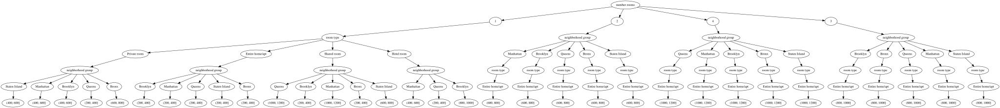

𝕋𝕙𝕖 𝕤𝕪𝕤𝕥𝕖𝕞'𝕤 𝕖𝕟𝕥𝕣𝕠𝕡𝕪 𝕚𝕤 2.5768269553111134 🎅


Error: no "view" mailcap rules found for type "application/pdf"
/usr/bin/xdg-open: 869: www-browser: not found
/usr/bin/xdg-open: 869: links2: not found
/usr/bin/xdg-open: 869: elinks: not found
/usr/bin/xdg-open: 869: links: not found
/usr/bin/xdg-open: 869: lynx: not found
/usr/bin/xdg-open: 869: w3m: not found
xdg-open: no method available for opening 'output/visualTree.gv.pdf'


In [70]:
# Your answer goes here
features = columns[:-1]
decisionTree = DecisionTree(dtX_train.tolist(), features.tolist(), dty_train.tolist(), "entropy")
decisionTree.id3(0,10)
dot = decisionTree.print_visualTree( render=True )
display(dot)

print(f"𝕋𝕙𝕖 𝕤𝕪𝕤𝕥𝕖𝕞'𝕤 𝕖𝕟𝕥𝕣𝕠𝕡𝕪 𝕚𝕤 {format(decisionTree.entropy)} 🎅")

What is the first feature the decision tree splits on? **(0.5 point)**

_Answer:_ The first feature the decision tree splits on is number of rooms ("number rooms")!



Since it doesn't make sense to set a price range for renting a room, we need to fix a price. For simplicity, we use the means of the bins, i.e., 125, 300, 500, 700, 900, and 1100. For example, if a room were categorized in the bin (200, 400], it would have the price of 300.

What prices are possible given your decision tree for:

- Manhattan, 1-room, Private room
- Staten Island, 1-room, Shared room

**(1 point)**

_Answer:_ The prices possible given our decision tree are:

- Manhattan, 1-room, Private room: 500
- Staten Island, 1-room, Shared room: 700



What is the proposed price of the decision tree for our apartment? Store it in a variable for later usage. **(1 point)**

In [66]:
# Your answer goes here
proposedPriceDT = 700

To evaluate how good our decision tree is for determining price categories, we want to measure the error of the predictions on the test set. To do so, the IDS team provided you helper functions below.

In [63]:
def get_name_value_dict(graph):
    id_label_dict = {}
    root = decisionTree.root
    visited = set() # Set to keep track of visited nodes of graph.

    def dfs(visited, graph, node):#function for dfs 
        id_label_dict[node.name] = node.value
        if node not in visited:
            if node.next:
                id_label_dict[node.next.name] = node.next.value
            visited.add(node)
            if node.childs:
                for child in node.childs:
                    if child is not None:
                        dfs(visited, graph, child)
            elif node.next:
                if node.next.childs:
                    for child in node.next.childs:
                        if child is not None:
                            dfs(visited, graph, child)
    dfs(visited, graph, root)
    return id_label_dict

def get_predictor(tree):
  id_label_dict = get_name_value_dict(tree)
  dotplus = pydotplus.graph_from_dot_data(tree.source)
  G = networkx.nx_pydot.from_pydot(dotplus)
  root = [n for n,d in G.in_degree() if d==0][0]
  paths = []
  for node in G:
      if G.out_degree(node)==0: #it's a leaf
          paths.append(networkx.shortest_path(G, root, node))
  new_paths = []
  for path in paths:
      for name, value in id_label_dict.items():
          path = ([p.replace(name, value) for p in path])
      new_paths.append(path)
  predictor = {}
  for path in new_paths.copy():
    target = path[-1]
    classification = tuple(path[:-1])
    predictor[classification] = target
  return predictor

def get_prediction_features(predictor):
    features = set()
    for key in predictor:
        i = 0
        while i <= len(key)-2:
            features.add(key[i])
            i +=2
    return features
            
def get_predicted_bin(instance, features, predictor):
  feature_values = {}
  for feature in features:
      feature_values[feature] = instance[feature]
  possible_paths = predictor.keys()
  i=0
  while i<2*len(feature_values):
    attribute = [path[i] for path in possible_paths][0]
    if attribute in predictor.values():
      break
    feature_value = feature_values[attribute]
    candidates = []
    for el in possible_paths:
      if str(el[i+1]) == str(feature_value):
        candidates.append(el)
    possible_paths = candidates.copy()
    i+=2
  return predictor[possible_paths[0]]



### Dot is your visual decision tree. Adjust the naming if needed
predictor = get_predictor(dot)
features = get_prediction_features(predictor)

To predict the price bin for each instance of your test set, apply the function get_predicted_bin using the variables *predictor* and *features* provided above. **(2 points)**

In [65]:
# Your answer goes here
predictedRanges = [get_predicted_bin({"number rooms": x[0], "neighborhood group": x[1], "room type": x[2]}, features, predictor) for x in dtX_test]

You predicted a price range for AirBnBs in your test set. However, since you cannot enter a price range for renting an apartment, we have to map the range of bins to one value. To do so, we use the mean of bins, as explained before, to predict the price. Given that, compute the mean absolute error between the prediction from the decision tree and the real price provided in the dataset. What is the mean absolute error? **(3 points)**

In [71]:
# Your answer goes here
def get_mean_price(range):
    pattern = r'\d+'
    limits = re.findall(pattern, range)
    return (int(limits[0]) + int(limits[1]))/2

predictedPriceMeans = [get_mean_price(x) for x in predictedRanges]
print(f"𝒯𝒽𝑒 𝓂𝑒𝒶𝓃 𝒶𝒷𝓈𝑜𝓁𝓊𝓉𝑒 𝑒𝓇𝓇𝑜𝓇 𝒾𝓈 {mean_absolute_error(airbnby_test, predictedPriceMeans)}")

𝒯𝒽𝑒 𝓂𝑒𝒶𝓃 𝒶𝒷𝓈𝑜𝓁𝓊𝓉𝑒 𝑒𝓇𝓇𝑜𝓇 𝒾𝓈 273.5913068021451


## Clustering (23 points)

Another way to do comparables pricing is to find similar apartments using clustering. Each calculated cluster represents one or more similar apartments in the dataset. For each cluster, you calculate the mean price as a representative price. To predict the price for new apartments, you assign them to an existing cluster and give the mean price as prediction.

Use the same features you used in the decision tree for the clustering as well (**number rooms, neighborhood group, room type**), and remember that your dataset is still split into a training and test set.

In this task, you will use the k-means algorithm.
*Note: To keep results comparable, please use 100 for random state and n_init when initializing the clustering algorithm. Also, remember to use the same test and training set as in the previous tasks to compare performances.*

### Encoding (2 points)

K-means tries to calculate the distance between different data points. Since some of the features you want to use are not numeric, apply one-hot encoding to be able to use distance measures. Use the preprocessing module of sklearn to prepare your dataset for clustering.

In [72]:
# Your answer goes here
ohe_kmeans = OneHotEncoder()
encodedTrainCat = ohe_kmeans.fit_transform(airbnbX_train[:, 1:]).toarray()
encodedClustXtrain = np.append(airbnbX_train[:, 0].reshape(-1, 1), encodedTrainCat, axis=1)

encodedTestCat = ohe_kmeans.transform(airbnbX_test[:, 1:]).toarray()
encodedClustXtest = np.append(airbnbX_test[:, 0].reshape(-1, 1), encodedTestCat, axis = 1)

### Choosing number of clusters (8 points)

In k-means, the number of wanted clusters is a parameter one can decide on. Since this is information you do not have at this time, you choose to use the data to decide.

You cluster on the training dataset by using `k` number of clusters where `k` is between 4 and 15. Since you are interested in the price, for each clustering, you calculate the **standard deviation of the mean prices for the clusters**. Therefore, for each clustering:
1. Calculate the mean price for each of the resulting clusters.
2. Calculate the standard deviation of the mean prices calculated in 1.

Plot a diagram where on the `x-axis` you will have the *number of clusters used* and on the `y-axis` the *standard deviation of the means*.

In your opinion, which amount of clusters makes more sense? Explain your answer.

𝑀𝑒𝒶𝓃 𝓅𝓇𝒾𝒸𝑒𝓈 𝒻𝑜𝓇 4-𝓂𝑒𝒶𝓃𝓈 𝒸𝓁𝓊𝓈𝓉𝑒𝓇𝒾𝓃𝑔 𝒶𝓇𝑒 [624.2947400343701, 531.5309000708717, 570.859365079365, 914.9820922442669]
𝚃𝚑𝚎 𝚜𝚝𝚊𝚗𝚍𝚊𝚛𝚍 𝚍𝚎𝚟𝚒𝚊𝚝𝚒𝚘𝚗 𝚘𝚏 𝚖𝚎𝚊𝚗 𝚙𝚛𝚒𝚌𝚎𝚜 𝚠𝚒𝚝𝚑 4 𝚌𝚕𝚞𝚜𝚝𝚎𝚛𝚜 𝚒𝚜 150.6157367123967
𝑀𝑒𝒶𝓃 𝓅𝓇𝒾𝒸𝑒𝓈 𝒻𝑜𝓇 5-𝓂𝑒𝒶𝓃𝓈 𝒸𝓁𝓊𝓈𝓉𝑒𝓇𝒾𝓃𝑔 𝒶𝓇𝑒 [914.9820922442669, 625.1352187141504, 528.9223037417462, 568.2545502680522, 622.3672899804633]
𝚃𝚑𝚎 𝚜𝚝𝚊𝚗𝚍𝚊𝚛𝚍 𝚍𝚎𝚟𝚒𝚊𝚝𝚒𝚘𝚗 𝚘𝚏 𝚖𝚎𝚊𝚗 𝚙𝚛𝚒𝚌𝚎𝚜 𝚠𝚒𝚝𝚑 5 𝚌𝚕𝚞𝚜𝚝𝚎𝚛𝚜 𝚒𝚜 136.32372615381774
𝑀𝑒𝒶𝓃 𝓅𝓇𝒾𝒸𝑒𝓈 𝒻𝑜𝓇 6-𝓂𝑒𝒶𝓃𝓈 𝒸𝓁𝓊𝓈𝓉𝑒𝓇𝒾𝓃𝑔 𝒶𝓇𝑒 [528.9223037417462, 622.3961099828152, 568.2545502680522, 629.9739202428591, 622.3672899804633, 914.9820922442669]
𝚃𝚑𝚎 𝚜𝚝𝚊𝚗𝚍𝚊𝚛𝚍 𝚍𝚎𝚟𝚒𝚊𝚝𝚒𝚘𝚗 𝚘𝚏 𝚖𝚎𝚊𝚗 𝚙𝚛𝚒𝚌𝚎𝚜 𝚠𝚒𝚝𝚑 6 𝚌𝚕𝚞𝚜𝚝𝚎𝚛𝚜 𝚒𝚜 124.8035814113948
𝑀𝑒𝒶𝓃 𝓅𝓇𝒾𝒸𝑒𝓈 𝒻𝑜𝓇 7-𝓂𝑒𝒶𝓃𝓈 𝒸𝓁𝓊𝓈𝓉𝑒𝓇𝒾𝓃𝑔 𝒶𝓇𝑒 [598.0200530137145, 539.3290391321193, 696.352508004269, 622.3961099828152, 622.3672899804633, 918.1523651452283, 497.08479469632164]
𝚃𝚑𝚎 𝚜𝚝𝚊𝚗𝚍𝚊𝚛𝚍 𝚍𝚎𝚟𝚒𝚊𝚝𝚒𝚘𝚗 𝚘𝚏 𝚖𝚎𝚊𝚗 𝚙𝚛𝚒𝚌𝚎𝚜 𝚠𝚒𝚝𝚑 7 𝚌𝚕𝚞𝚜𝚝𝚎𝚛𝚜 𝚒𝚜 127.31291355562931
𝑀𝑒𝒶𝓃 𝓅𝓇𝒾𝒸𝑒𝓈 𝒻𝑜𝓇 8-𝓂𝑒𝒶𝓃𝓈 𝒸𝓁𝓊𝓈𝓉𝑒𝓇𝒾𝓃𝑔 𝒶𝓇𝑒 [629.9739202428591, 539.3290391321193, 718.9406340785652, 622.3961099828152, 622.3

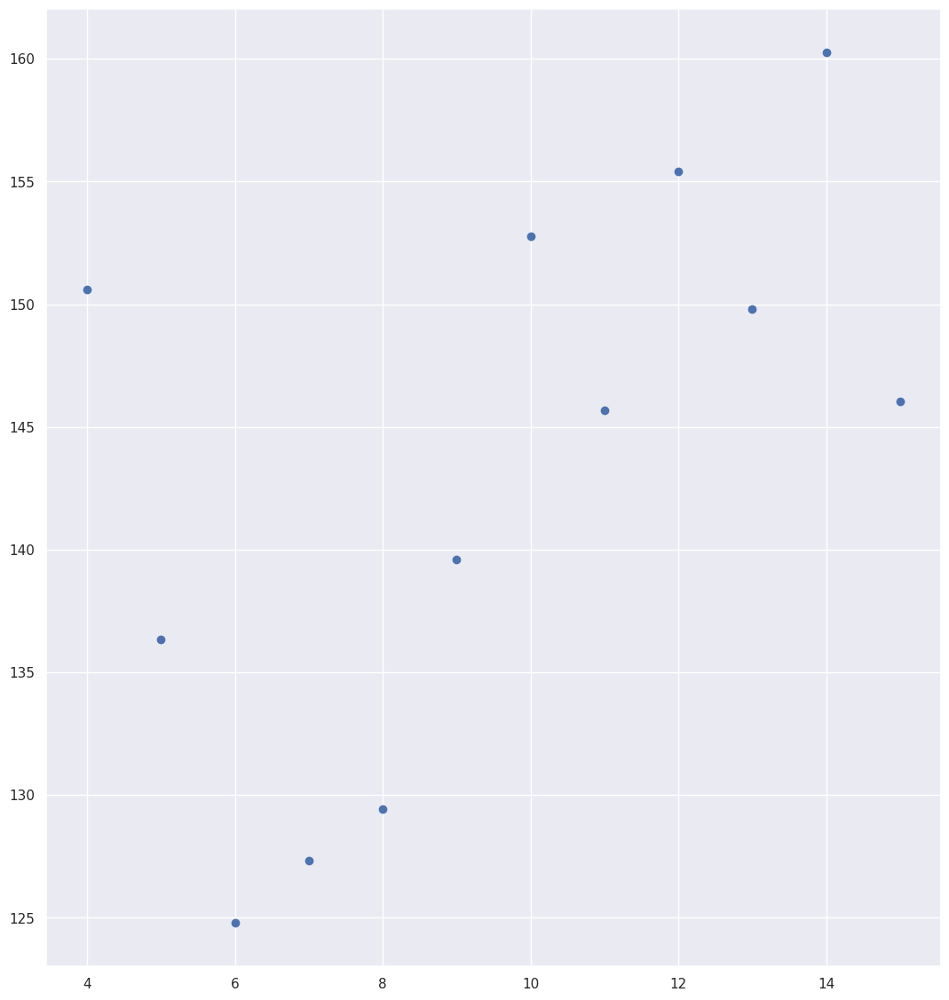

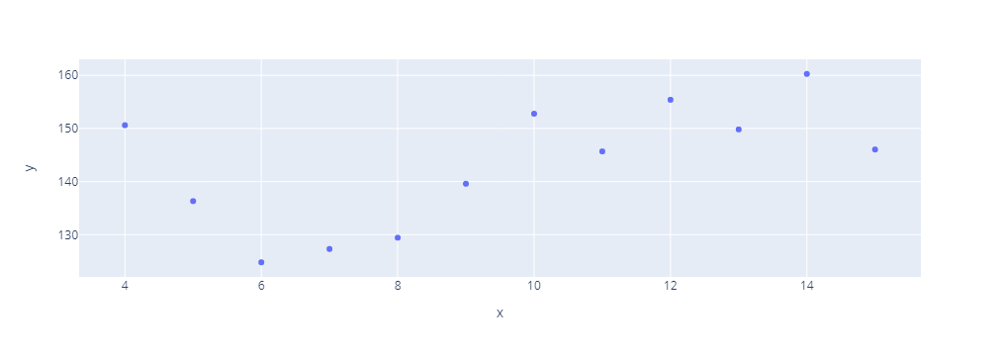

In [76]:
# Your answer goes here
k_list = [i for i in range(4, 16)]
std_list = []
for k in k_list:
    kmeans = KMeans(n_clusters=k, random_state=100, n_init=100)
    kmeans.fit(encodedClustXtrain)
    cluster_labels = kmeans.labels_
    unique_labels = set(cluster_labels)
    mean_prices = []
    for l in unique_labels:
        prices = airbnby_train[np.where(cluster_labels == l)]
        mean_prices.append(prices.mean())
    print(f"𝑀𝑒𝒶𝓃 𝓅𝓇𝒾𝒸𝑒𝓈 𝒻𝑜𝓇 {𝓀}-𝓂𝑒𝒶𝓃𝓈 𝒸𝓁𝓊𝓈𝓉𝑒𝓇𝒾𝓃𝑔 𝒶𝓇𝑒 {mean_prices}")
    stDev = np.array(mean_prices).std()
    print(f"𝚃𝚑𝚎 𝚜𝚝𝚊𝚗𝚍𝚊𝚛𝚍 𝚍𝚎𝚟𝚒𝚊𝚝𝚒𝚘𝚗 𝚘𝚏 𝚖𝚎𝚊𝚗 𝚙𝚛𝚒𝚌𝚎𝚜 𝚠𝚒𝚝𝚑 {𝚔} 𝚌𝚕𝚞𝚜𝚝𝚎𝚛𝚜 𝚒𝚜 {stDev}")
    std_list.append(stDev)
    
    
plt.scatter(k_list, std_list)
plt.show()

fig = px.scatter(x=k_list, y=std_list)
fig.show()

_Answer:_ Since we are only considering the standard deviation of the mean prices of the clusters, it makes more sense to choose k which leads to higher standard deviation implicating the clusters are comparatively farther from each other. On the other hand, we shouldn't choose too high value of k as it adds additional computational cost while labeling new data. So, k=10 seems like a good tradeoff between higher standard deviation and lower complexity.


**Note:** No matter the conclusion made in the previous task, from now on, you use the clustering model with **9 clusters** for predicting the price for your apartment and evaluating the clustering technique.

### Pricing your apartment (3 points)

To predict the price for your apartment, calculate in which cluster your apartment would be and use the mean value of the cluster as a possible price.

In [79]:
# Your answer goes here
# cluster for 9 clusters
kmeans = KMeans(n_clusters=9, random_state=100, n_init=100)
kmeans.fit(encodedClustXtrain)
cluster_labels = kmeans.labels_
apartment_data = [np.append([[2]], ohe_kmeans.transform([['Manhattan', 'Entire home/apt']]).toarray())]
apartment_cluster = kmeans.predict(apartment_data)
prices = airbnby_train[np.where(cluster_labels == apartment_cluster[0])]
proposedPriceCluster = prices.mean()
print(f"𝒯𝒽𝑒 𝓅𝓇𝑒𝒹𝒾𝒸𝓉𝑒𝒹 𝓅𝓇𝒾𝒸𝑒 🤑 𝑜𝒻 𝑜𝓊𝓇 𝒶𝓅𝒶𝓇𝓉𝓂𝑒𝓃𝓉 🏠 𝓊𝓈𝒾𝓃𝑔 𝒸𝓁𝓊𝓈𝓉𝑒𝓇𝒾𝓃𝑔 𝒾𝓈 {proposedPriceCluster}.")

𝒯𝒽𝑒 𝓅𝓇𝑒𝒹𝒾𝒸𝓉𝑒𝒹 𝓅𝓇𝒾𝒸𝑒 🤑 𝑜𝒻 𝑜𝓊𝓇 𝒶𝓅𝒶𝓇𝓉𝓂𝑒𝓃𝓉 🏠 𝓊𝓈𝒾𝓃𝑔 𝒸𝓁𝓊𝓈𝓉𝑒𝓇𝒾𝓃𝑔 𝒾𝓈 718.9406340785652.


### Evaluating clustering (10 points)

You want to evaluate how well your clustering worked. In your case, two things can be evaluated:

1.   Whether the clustering technique can group similar apartments together
2.   Whether other people determine the price of their apartment as you did, meaning whether similar apartments get a similar price

You are going to evaluate the clustering technique visually. The IDS team provides you with the following fancy code that reduces your input to two dimensions.

In [84]:
import umap.umap_ as umap

#Preprocessing numerical
full_data = pd.DataFrame(airbnbX_train, columns=airbnb.columns[:3]).infer_objects() # use the train dataset here
numerical = full_data.select_dtypes(exclude='object')

for c in numerical.columns:
    pt = sklearn.preprocessing.PowerTransformer()
    numerical.loc[:, c] = pt.fit_transform(np.array(numerical[c]).reshape(-1, 1))
    
##preprocessing categorical
categorical = full_data.select_dtypes(include='object')
categorical = pd.get_dummies(categorical)

#Percentage of columns which are categorical is used as weight parameter in embeddings later
categorical_weight = len(full_data.select_dtypes(include='object').columns) / full_data.shape[1]

#Embedding numerical & categorical
fit1 = umap.UMAP(metric='l2').fit(numerical)
fit2 = umap.UMAP(metric='dice').fit(categorical)

#Augmenting the numerical embedding with categorical
intersection = umap.general_simplicial_set_intersection(fit1.graph_, fit2.graph_, weight=categorical_weight)
intersection = umap.reset_local_connectivity(intersection)
embedding = umap.simplicial_set_embedding(fit1._raw_data, intersection, fit1.n_components,
                                                fit1._initial_alpha, fit1._a, fit1._b,
                                                fit1.repulsion_strength, fit1.negative_sample_rate,
                                                200, 'random', np.random, fit1.metric,
                                                fit1._metric_kwds, False, {}, False)

# Extracting the resulting dimensions
dimension1 = embedding[0].T[0]
dimension2 = embedding[0].T[1]

/opt/conda/lib/python3.9/site-packages/umap/umap_.py:1802: UserWarning:

gradient function is not yet implemented for dice distance metric; inverse_transform will be unavailable



Create a scatter plot from the two dimensions and use the cluster labels for coloring the data points. Use the train set for the visualization. Discuss the result. **(5 points)**

<AxesSubplot:>

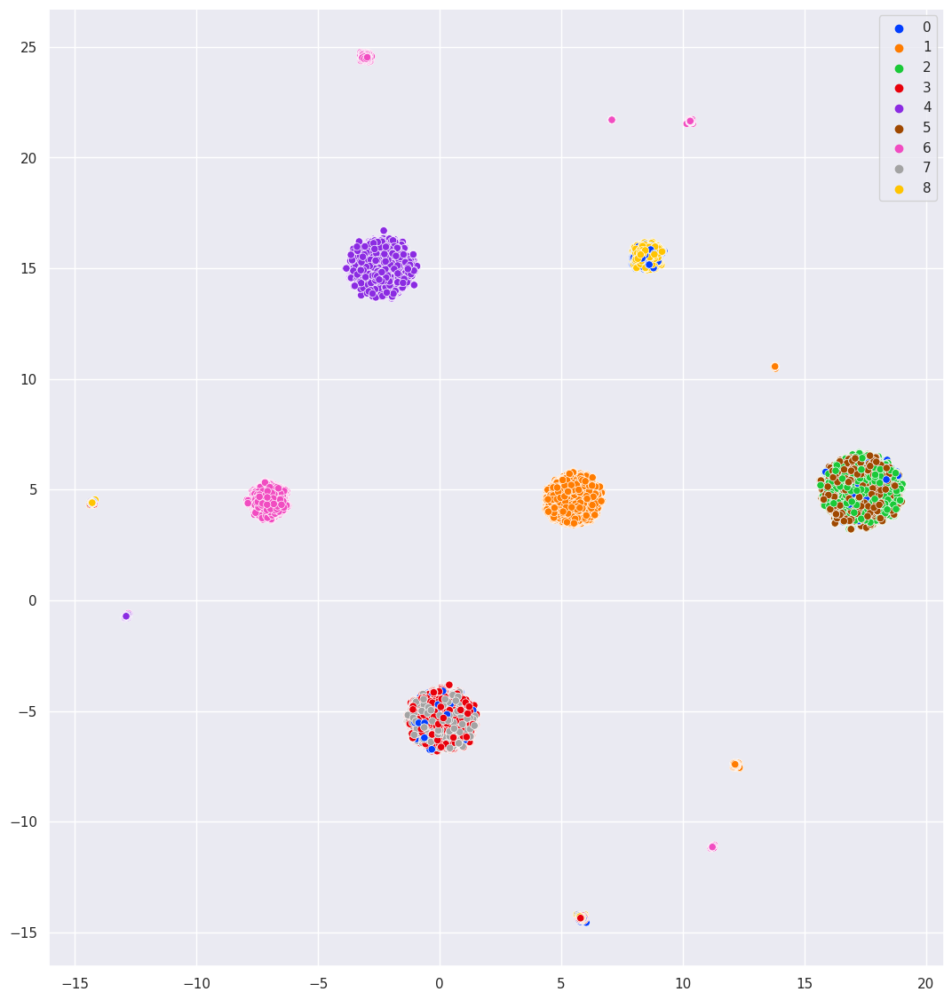

In [105]:
# Your answer goes here
palette = sns.color_palette("bright", 9)
sns.scatterplot(x=dimension2, y=dimension1, legend='full', hue=cluster_labels, palette=palette)

_Answer:_ From the visualization in 2-dimensions, we can see that some of the clusters are not well separated in some cases. Also, some well defined clusters (1, 4 and 6) have outliers. So the clustering is not optimal to predict prices to apartments where we want similar prices for similar apartments. Also in the visualization without any price data, we are unable to comment anything on similar apartments.



We next evaluate whether similar apartments (considering the attributes we chose) get similar prices. To do this, we use our test set. Assign each apartment of the test set to the nearest centroid. Predict the price of the apartments in the test set by taking the mean price of the cluster they was assigned to. Calculate the mean absolute error between the predicted and real prices. **(5 points)**

In [106]:
# Your answer goes here
predicted_clusters = kmeans.predict(encodedClustXtest)
unique_labels = set(cluster_labels)
mean_prices = {}
for l in unique_labels:
    prices = airbnby_train[np.where(cluster_labels == l)]
    mean_prices[l] = prices.mean()
predicted_prices = [mean_prices[c] for c in predicted_clusters]
print(f"(っ◔◡◔)っ ♥ The mean absolute error between the predicted and real price for clustering is {mean_absolute_error(airbnby_test, predicted_prices)}. ♥")

(っ◔◡◔)っ ♥ The mean absolute error between the predicted and real price for clustering is 262.8750773326119. ♥


## Final comments on the price prediction (2 points)

Please compare the three approaches used for determining the price. Do they provide a good way of determining the price?

_Answer:_ Comparing the three approaches (baseline, decision tree and clustering), we see that all of them doesn't provide sufficient performance to determine the price of the apartments precisely. Also, there is not enough improvement in the performance compared to the baseline for both the decision tree and the clustering models justifying the additional complexity. But overall, clustering gives us the best performance in terms of mean absolute error. 



## Question 3: Investigating Price Elasticity (32 Points)

You show your results to Toby, excited about the price suggestions you got from the decision tree and clustering. You decide to take the higher price, which naturally means more income.

However, he points you to one central flaw in your thinking: The number of bookings is not independent of the price. Therefore, you can not just take any price and assume that this will lead to more income than a lower price, as the demand (utilization) for your apartment might decrease. This is called **price elasticity**.

You want to verify what Toby has been telling you. You extracted the utilization column of your dataset by grabbing the available data from AirBnB's calendar (smart!). The utilization values are contained in dataset **AirBnB_utilization.csv**. **Show several graphs investigating price elasticity.** For example, you might plot the utilization in relation to the price and color according to different variable values. 
After you have verified Toby's statements, you want to learn price elasticity from the dataset (the utilization of an apartment given the price, the number of rooms, the room type, and the neighborhood group, i.e., the same features as before). With the learned price elasticity, you want to evaluate which of the proposed prices (decision tree or clustering) is the better choice. **(2 points)**

In [ ]:
# Your answer goes here


You will investigate the relationship between price and utilization in this subtask. First, you will train different models and choose the one that best predicts utilization for an apartment. Second, you will evaluate which of the proposed prices of decision tree and clustering prices were better, assuming that your model provides the correct utilization. Third, you will conclude your investigation and provide a pricing decision.

### Learning price elasticity (25 points)
You want to use different supervised learning techniques to learn price elasticity. You decide on linear regression, SVM, and multilayer perceptrons. However, you have to preprocess the data. Use the features of the neighborhood group, the room type, the number of rooms, and the price to predict the utilization. Split into training and testing data (test size 5%).

#### Prepare the data set by splitting, one-hot encoding, and normalizing. (5 points)

In [ ]:
# Your answer goes here


For each technique, use 5-cross-fold validation for hyperparameter optimization and assess the performance on the test set. 

#### Regression (5 points)

Learn a linear regression to predict the utilization of an AirBnB.

In [ ]:
# Your answer goes here


What is the mean absolute error achieved on the test data?

In [ ]:
# Your answer goes here


Show (draw!) the price elasticity for your apartment. 

In [ ]:
# Your answer goes here


#### Linear SVR (5 points)

Train and evaluate a Linear SVR (Support Vector Regression) model.

In [ ]:
# Your answer goes here


What is the mean absolute error achieved on the test data?

In [ ]:
# Your answer goes here


Show (draw!) the price elasticity for your apartment. 

In [ ]:
# Your answer goes here


#### Learning Non-Linear Relationships

You realize that learning linear relationships only provides limited performance. You want to learn non-linear relationships. First, you will learn non-linear relationships using linear regression and kernels. Second, you will use non-linear kernels in the Support Vector Regression. Third, you will use neural networks.

#### Kernels in Regression (2.5 points)

Use a transformation of the price and a regression to incorporate non-linear relationships, as learned in the lecture. You can try different kernel functions, but at least you should use one quadratic kernel.

In [ ]:
# Your answer goes here


What is the mean absolute error achieved on the test data?

In [ ]:
# Your answer goes here


Show (draw!) the price elasticity for your apartment. 

In [ ]:
# Your answer goes here


#### Kernels in SVR (2.5 points)

Train and evaluate an SVR (Support Vector Regression) model with different, non-linear kernels. You can limit the size of your training set to 25000 samples to make the problem feasible in computation time.

In [ ]:
# Your answer goes here


What is the mean absolute error achieved on the test data?

In [ ]:
# Your answer goes here


Show (draw!) the price elasticity for your apartment. 

In [ ]:
# Your answer goes here


What is your conclusion on using kernels?

_Answer:_



#### Neural Network (5 points)

Learn a neural network (multilayer perceptron) to predict the utilization of an AirBnB.

In [ ]:
# Your answer goes here


What is the mean absolute error achieved on the test data?

In [ ]:
# Your answer goes here


Show (draw!) the price elasticity for your apartment. 

In [ ]:
# Your answer goes here


### Profit discrepencies when incorporating price elasticity (5 points)

Use the model that best captures price elasticity on the testing set. You can assume that this model accurately captures price elasticity, i.e., is the ground truth. What is the better of the two proposed prices? Is the better price the optimal price?

In [ ]:
# Your answer goes here


_Answer:_



# Question 4: Conclusion (5 points)

Summarize your findings and discuss limitations.

_Answer:_ 

